<a href="https://colab.research.google.com/github/yaolihua081/AIG_PC/blob/main/AutomaticScoringFeaturetractionMarch2022.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

Your runtime has 27.3 gigabytes of available RAM

You are using a high-RAM runtime!


In [ ]:
gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

Wed Dec 29 18:23:48 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 495.44       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   35C    P0    26W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# **Import Package**

In [ ]:
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix #Import scikit-learn metrics module for accuracy calculation


In [ ]:
!pip install pyspellchecker
# import all necessary libraries

# For dataframes
import pandas as pd 

# For numerical arrays
import numpy as np 

# For stemming/Lemmatisation/POS tagging
import spacy

# For getting stopwords
from spacy.lang.en.stop_words import STOP_WORDS

# For K-Fold cross validation
from sklearn.model_selection import KFold

# For visualizations
import matplotlib.pyplot as plt

# For regular expressions
import re

# For handling string
import string

# For all torch-supported actions
import torch

# For spell-check
from spellchecker import SpellChecker

# For performing mathematical operations
import math

# For dictionary related activites
from collections import defaultdict

# For counting actions (EDA)
from collections import  Counter

# For count vectorisation (EDA)
from sklearn.feature_extraction.text import CountVectorizer

# For one-hot encoding
from tensorflow.keras.utils import to_categorical

# For DL model
from tensorflow.keras.layers import Dense, Input, GlobalMaxPooling1D
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Embedding, LSTM
from tensorflow.keras.models import Model, Sequential

# For generating random integers
from random import randint

# For TF-IDF vectorisation
from sklearn.feature_extraction.text import TfidfVectorizer

# For padding
from tensorflow.keras.preprocessing.sequence import pad_sequences

# For tokenization
from tensorflow.keras.preprocessing.text import Tokenizer

# For plotting
import seaborn as sns

print("Necessary libraries imported")

# Constant variables 

# spaCy language lemmatiser model
sp=spacy.load('en_core_web_sm')
spell = SpellChecker()

print("Constant variables ready")

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

     |████████████████████████████████| 2.7 MB 3.8 MB/s 
Necessary libraries imported
Constant variables ready


In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
#need to load train.cvs and test_cvs
from google.colab import files
files.upload()

Saving test_set.tsv to test_set.tsv
Saving training_set_rel3.tsv to training_set_rel3.tsv
Saving valid_sample_submission_5_column.csv to valid_sample_submission_5_column.csv
Saving valid_set.tsv to valid_set.tsv


{'test_set.tsv': b'essay_id\tessay_set\tessay\tdomain1_predictionid\tdomain2_predictionid\n2383\t1\t"I believe that computers have a positive effect on people. They help you stay in touch with family in a couple different ways they excercise your mind and hands and help you learn and make things easier. Computer\'s help you keep in touch with people. Say you live in @LOCATION1 and you miss your @CAPS1. You can just send an e-mail and talk all you want. If you don\'t just want to limit it to words you can add pictures so they can see how much you\'ve grown or if you are well. Even if you\'re just e-mailing someone down the block it is just as effective as getting up and walking over there. You can also use a computer to make a scrap book card or slide show to show how much you love the person you give them to. Computers @MONTH1 not excercise you whole body but it excersises you mind and hands. You could play solitaire on the computer and come away @PERCENT1 smarter than before. You can 

#https://medium.com/glose-team/how-to-evaluate-text-readability-with-nlp-9c04bd3f46a2
#https://medium.com/glose-team/how-to-evaluate-text-readability-with-nlp-9c04bd3f46a2

#https://pypi.org/project/textstat/

#Readability, on the other hand, focuses on textual content such as lexical, semantical, syntactical and discourse cohesion analysis. It is usually computed in a very approximate manner, using average sentence length (in characters or words) and average word length (in characters or syllables) in sentences.
#Mean number of syllables per word,
Mean number of words per sentence,
Mean number of words considered “difficult” in a sentence (a word is “difficult” if it is not part of an “easy” words reference list),
Part-of-Speech (POS) tags count per book,
Readability formulas such as Flesch-Kincaid and
Number of polysyllables (more than 3 syllables).
#however we would like to have a similar scale from -1 to 1 because some of the algorithms we use during modelling (Support Vector Regression with a Linear kernel and Linear regression) assume that the data given as input follows a Gaussian distribution. 

#RF_result1.csv, result with essay_set not considered.
#Now consider essay_set and notmilazated it.

#**Read in data and do some checking**

In [ ]:

#three rater, each essay has 6 traits, two raters,each with 6 scores for 6 traits
#max score for each domain1, domain 2 is 30, max score for domain_score is 60
#max score for each trait is 6

#train_all = pd.read_csv('training_set_rel3.tsv',sep="\t",header=0,encoding= 'unicode_escape')
#train_all = pd.read_csv('training_set_rel3.tsv',sep="\t",header=0,encoding='ISO-8859-1')
#domain1_score is the sum of rater1_domain1+rater2_domain1
train_all = pd.read_csv('training_set_rel3.tsv',sep="\t",header=0,encoding='ISO-8859-1')
train_all=train_all.drop_duplicates(ignore_index=True)
test_all = pd.read_csv('test_set.tsv',sep="\t",header=0,encoding='ISO-8859-1')

validation = pd.read_csv('valid_set.tsv',sep="\t",header=0,encoding='ISO-8859-1')
#domain1_predictionid: A unique prediction_id that corresponds to the predicted_score on the essay for domain 1; all essays have this
#domain2_predictionid: A unique prediction_id that corresponds to the predicted_score on the essay for domain 2; only essays in set 2 have this
valid_predict=pd.read_csv('valid_sample_submission_5_column.csv')
df1=validation
df2=valid_predict
validation_all=df1.merge(df2, left_on='domain1_predictionid', right_on='prediction_id')
validation_all['domain1_score']=validation_all['predicted_score']
validation_all['essay_set']=validation_all['essay_set_x']
validation_all['essay_id']=validation_all['essay_id_x']

#validation_all=validation_all.drop(labels=['ssay_id_x','essay_set_x','essay_id_y'],axis=1)

In [ ]:
validation_all.describe()

,essay_id_x,essay_set_x,domain1_predictionid,domain2_predictionid,prediction_id,essay_id_y,essay_set_y,essay_weight,predicted_score,domain1_score,essay_set,essay_id
count,4218.000000,4218.000000,4218.000000,600.000000,4218.000000,4218.000000,4218.000000,4218.000000,4218.000000,4218.000000,4218.000000,4218.000000
mean,11282.446420,4.123518,13735.433618,7178.000000,13735.433618,11282.446420,4.123518,0.928876,6.654576,6.654576,4.123518,11282.446420
std,6173.633131,2.117188,6964.020021,346.698716,6964.020021,6173.633131,2.117188,0.174673,8.799343,8.799343,2.117188,6173.633131
min,1788.000000,1.000000,1788.000000,6579.000000,1788.000000,1788.000000,1.000000,0.500000,0.000000,0.000000,1.000000,1788.000000
25%,5243.250000,2.000000,7508.500000,6878.500000,7508.500000,5243.250000,2.000000,1.000000,2.000000,2.000000,2.000000,5243.250000
50%,10995.500000,4.000000,13995.500000,7178.000000,13995.500000,10995.500000,4.000000,1.000000,3.000000,3.000000,4.000000,10995.500000
75%,16852.750000,6.000000,19852.750000,7477.500000,19852.750000,16852.750000,6.000000,1.000000,8.000000,8.000000,6.000000,16852.750000
max,21938.000000,8.000000,24938.000000,7777.000000,24938.000000,21938.000000,8.000000,1.000000,50.000000,50.000000,8.000000,21938.000000


In [ ]:
pd.set_option('display.max_rows', None)
df=train_all
print('\nNull Statistics (in %): ')
print(df.isnull().sum()* 100 / len(df))


Null Statistics (in %): 
essay_id           0.000000
essay_set          0.000000
essay              0.000000
rater1_domain1     0.000000
rater2_domain1     0.000000
rater3_domain1    99.013564
domain1_score      0.000000
rater1_domain2    86.128237
rater2_domain2    86.128237
domain2_score     86.128237
rater1_trait1     82.336621
rater1_trait2     82.336621
rater1_trait3     82.336621
rater1_trait4     82.336621
rater1_trait5     94.428175
rater1_trait6     94.428175
rater2_trait1     82.336621
rater2_trait2     82.336621
rater2_trait3     82.336621
rater2_trait4     82.336621
rater2_trait5     94.428175
rater2_trait6     94.428175
rater3_trait1     99.013564
rater3_trait2     99.013564
rater3_trait3     99.013564
rater3_trait4     99.013564
rater3_trait5     99.013564
rater3_trait6     99.013564
dtype: float64


In [ ]:
print('\nEssay prompt frequency: ')
print(df.essay_set.value_counts())


Essay prompt frequency: 
5    1805
2    1800
6    1800
1    1783
4    1770
3    1726
7    1569
8     723
Name: essay_set, dtype: int64


Graph for score vs average word length


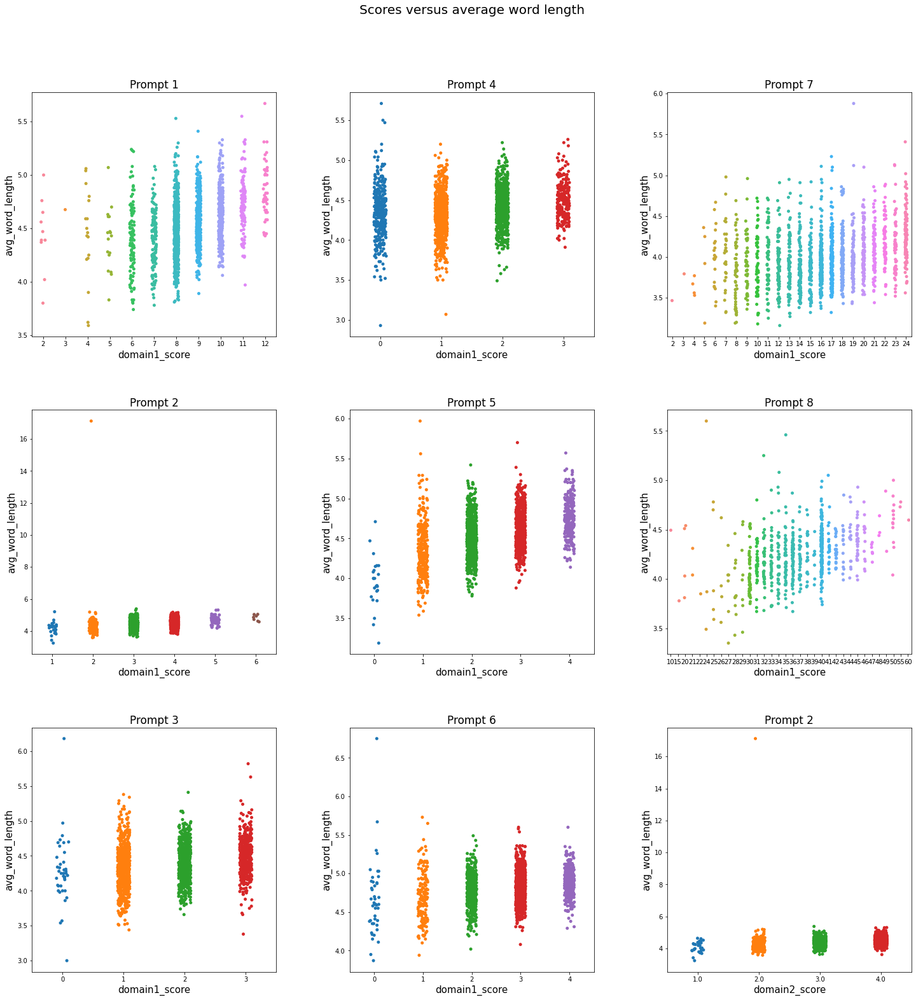

In [ ]:
def get_avg_length(essay):
    summ=0
    for word in essay.split():
        summ+=len(word)
    return round(summ/len(essay.split()),2)

df['avg_word_length']=df.essay.apply(lambda x: get_avg_length(x))
print("Graph for score vs average word length")

fig, axes = plt.subplots(3, 3, figsize=(24,24)) # creating a figure with 3 rows and 3 columns of plots
fig.suptitle('Scores versus average word length',fontsize=20)

for prompt in range(0,8):
  curdf=df[df['essay_set']==prompt+1]  
  g=sns.stripplot(ax=axes[prompt%3,math.floor(prompt/3)],
    data=curdf,
    x="domain1_score", y="avg_word_length")
  g.set_xlabel("domain1_score",fontsize=15)
  g.set_ylabel("avg_word_length",fontsize=15)
  axes[prompt%3,math.floor(prompt/3)].set_title("Prompt "+str(prompt+1),fontsize=17)

prompt=1
curdf=df[df['essay_set']==prompt+1]  
g=sns.stripplot(ax=axes[2,2],
    data=curdf,
    x="domain2_score", y="avg_word_length")
g.set_xlabel("domain2_score",fontsize=15)
g.set_ylabel("avg_word_length",fontsize=15)
axes[2,2].set_title("Prompt "+str(prompt+1),fontsize=17)

plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.3, 
                    hspace=0.3)

fig.savefig("average word length.jpg")
fig.show()


Graph for score vs total words


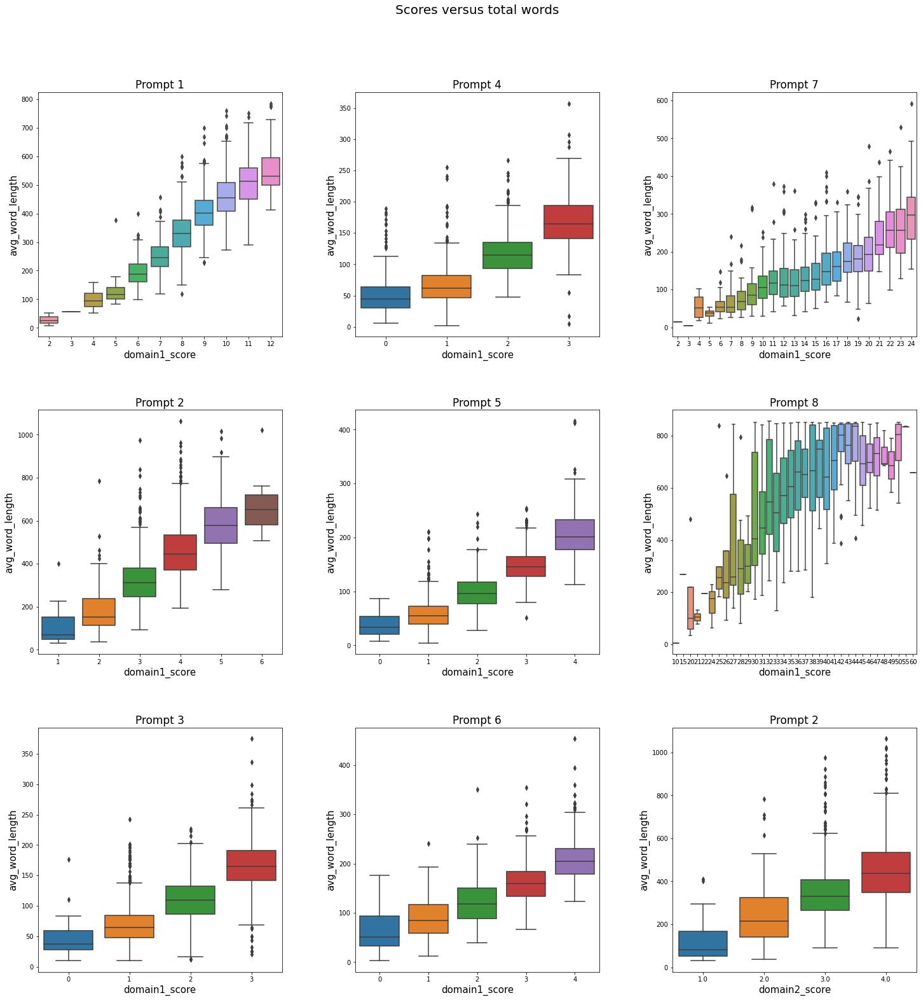

In [ ]:
print("Graph for score vs total words")


df['total_words']=df.essay.apply(lambda x: len(x.split()))
fig, axes = plt.subplots(3, 3, figsize=(24,24)) # creating a figure with 3 rows and 3 columns of plots
fig.suptitle('Scores versus total words',fontsize=20)

for prompt in range(0,8):
  curdf=df[df['essay_set']==prompt+1]  
  g=sns.boxplot(ax=axes[prompt%3,math.floor(prompt/3)],
    data=curdf,
    x="domain1_score", y="total_words")
  g.set_xlabel("domain1_score",fontsize=15)
  g.set_ylabel("atotal_words",fontsize=15)
  axes[prompt%3,math.floor(prompt/3)].set_title("Prompt "+str(prompt+1),fontsize=17)

prompt=1
curdf=df[df['essay_set']==prompt+1]  
g=sns.boxplot(ax=axes[2,2],
    data=curdf,
    x="domain2_score", y="total_words")
g.set_xlabel("domain2_score",fontsize=15)
g.set_ylabel("atotal_words",fontsize=15)
axes[2,2].set_title("Prompt "+str(prompt+1),fontsize=17)

plt.subplots_adjust(left=0.1,
                    bottom=0.1, 
                    right=0.9, 
                    top=0.9, 
                    wspace=0.3, 
                    hspace=0.3)
fig.savefig("Total Words.jpg")
fig.show()

In [ ]:
import gensim,spacy
from gensim.utils import simple_preprocess
from gensim.parsing.preprocessing import STOPWORDS
from gensim import models, corpora
from nltk.corpus import stopwords 

# NLTK Stop words
import nltk
#nltk.download('all')

from nltk.stem import WordNetLemmatizer, SnowballStemmer,PorterStemmer
from nltk import word_tokenize
from nltk.corpus import stopwords
from nltk.tokenize import sent_tokenize, word_tokenize
nltk.download('punkt')
nltk.download('stopwords')
stemmer = SnowballStemmer("english")
porter=PorterStemmer()
nltk.download('wordnet')
STOPWORDS = stopwords.words('english')
#STOPWORDS.extend(['passage','from', 'subject', 're', 'edu', 'use', 'not', 'would', 'say', 'could', '_', 'be', 'know', 'good', 'go', 'get', 'do', 'done', 'try', 'many', 'some', 'nice', 'thank', 'think', 'see', 'rather', 'easy', 'easily', 'lot', 'lack', 'make', 'want', 'seem', 'run', 'need', 'even', 'right', 'line', 'even', 'also', 'may', 'take', 'come'])
STOPWORDS.extend(['@', 're', 'not', '_', "0","1","2","3","4","5","6","7","8","9"])

tmp = nltk.download(['stopwords', 'gutenberg','punkt'], quiet=True) # See https://www.nltk.org/book/ch02.html
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer, HashingVectorizer
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.datasets import fetch_20newsgroups
from sklearn.naive_bayes import MultinomialNB,GaussianNB
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression,Lasso,Ridge
from sklearn import svm
from sklearn.neighbors import KNeighborsClassifier
from sklearn.neural_network import MLPClassifier
from sklearn.svm import LinearSVC
from keras.models import Sequential
from keras.layers import Dense, LSTM, SimpleRNN, Flatten
from keras.layers.embeddings import Embedding
from keras.layers.convolutional import Conv1D, MaxPooling1D
from numpy import loadtxt
from keras.layers import Dense
from sklearn.tree import DecisionTreeClassifier


[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.


Train data, prompt 2 has domain2-score, with 1800 sizes. What to do with it?
Same id, same essay, but domain2_score, which is different from domain1-score.
Shoudl I define it as essay_set=9????? Would that increase the noise?
Try out

#This will not be used

In [ ]:
dataset=pd.DataFrame(columns=["essay_set","essay_id","essay","score",'avg_word_length','total_words'])

for i in range(0,8):
  df2=df[df.essay_set==i+1].rename(columns={"domain1_score":"score"}).loc[:,["essay_set","essay_id","essay","score",'avg_word_length','total_words']]
  dataset=pd.concat([dataset,df2])
df2=df[df.essay_set==2].rename(columns={"domain2_score":"score"}).loc[:,["essay_set","essay_id","essay","score",'avg_word_length','total_words']]
df2['essay_set']=9
dataset=pd.concat([dataset,df2])
train_set=dataset

In [ ]:
##This plot has all 9 promopt
df=train_set
fig, axes = plt.subplots(3, 3, figsize=(24,24)) # creating a figure with 3 rows and 3 columns of plots
fig.suptitle('Scores versus average word length',fontsize=20)

for prompt in range(0,9):
  curdf=df[df['essay_set']==prompt+1]  
  g=sns.stripplot(ax=axes[prompt%3,math.floor(prompt/3)],
    data=curdf,
    x="score", y="avg_word_length")
  g.set_xlabel("score",fontsize=15)
  g.set_ylabel("avg_word_length",fontsize=15)
  axes[prompt%3,math.floor(prompt/3)].set_title("Prompt "+str(prompt+1),fontsize=17)

fig.savefig("average word length.jpg")
fig.show()


##Now will do the same thing for validation data. Validation data has no domain2-score



In [ ]:
df=validation_all
df['avg_word_length']=df.essay.apply(lambda x: get_avg_length(x))
df['total_words']=df.essay.apply(lambda x: len(x.split()))
dataset=pd.DataFrame(columns=["essay_set","essay_id","essay","score",'avg_word_length','total_words'])
for i in range(0,8):
  df2=df[df.essay_set==i+1].rename(columns={"domain1_score":"score"}).loc[:,["essay_set","essay_id","essay","score",'avg_word_length','total_words']]
  dataset=pd.concat([dataset,df2])
dataset=pd.concat([dataset,df2])
validation_set=dataset

df=test_all
df['avg_word_length']=df.essay.apply(lambda x: get_avg_length(x))
df['total_words']=df.essay.apply(lambda x: len(x.split()))
dataset=pd.DataFrame(columns=["essay_set","essay_id","essay",'avg_word_length','total_words'])
df=test_all
for i in range(0,8):
  df2=df[df.essay_set==i+1].loc[:,["essay_set","essay_id","essay",'avg_word_length','total_words']]
  dataset=pd.concat([dataset,df2])
test_set=dataset

In [ ]:
train_score=train_set
validation_score=validation_set
test_score=test_set
train_tokens=train_score['essay'].values
validation_tokens=validation_score['essay'].values
test_tokens=test_score['essay'].values

# **Start here. Prepara data**

In [ ]:
df.shape

(12976, 30)

In [ ]:
i=2
filter=df['essay_set']==i
set(df[filter].avg_word_length)

In [ ]:
##I wnat to use oly 6 essy-set, delete et 7 and 8

filter=train_all['essay_set']<=6
train_score=train_all[filter]
filter=validation_all['essay_set']<=6
validation_score=validation_all[filter]
filter=test_all['essay_set']<=6
test_score=test_all[filter]

In [ ]:
df=train_score

In [ ]:
#train_score=train_all
#validation_score=validation_all
#test_score=test_all
train_tokens=train_score['essay'].values
validation_tokens=validation_score['essay'].values
test_tokens=test_score['essay'].values

In [ ]:
train_tokens[1]

In [ ]:

#train_tokens=train_1_Gold['essay'].values
#test_tokens=validation_1_Gold['essay'].values
#!pip install pyspellchecker
#from spellchecker import SpellChecker
#spell = SpellChecker()
#import string
def correct_spellings(text):
    corrected_text = []
    misspelled_words = spell.unknown(text.split())
    for word in text.split():
        if word in misspelled_words:
            corrected_text.append(spell.correction(word))
        else:
            corrected_text.append(word)
    return " ".join(corrected_text)

def remove_punct(text):
    punctuation_counter=0
    for i in string.punctuation:
      punctuation_counter+=text.count(i)
    
    translator = str.maketrans(string.punctuation, ' '*len(string.punctuation))
    text=text.translate(translator)
    return re.sub(' +', ' ', text)


def lemmatize_stemming(text):
    return stemmer.stem(WordNetLemmatizer().lemmatize(text, pos='v'))

def preprocess(text):
    result=[]
    #text_=correct_spellings(text)
    #text_=remove_punct(text_)
    for token in gensim.utils.simple_preprocess(text) :
        if token not in gensim.parsing.preprocessing.STOPWORDS and len(token) > 2:
            result.append(lemmatize_stemming(token))
            
    return result

'''
Step 7
'''
train_processed_docs = [] # a list of a list of word

for doc in train_tokens:
    train_processed_docs.append(preprocess(doc))

test_processed_docs = [] # a list of a list of word

for doc in test_tokens:
    test_processed_docs.append(preprocess(doc)) 

validation_processed_docs = [] # a list of a list of word

for doc in validation_tokens:
    validation_processed_docs.append(preprocess(doc))    


In [ ]:
def process_words(data_words, stop_words=STOPWORDS, allowed_postags=['NOUN', 'ADJ', 'VERB', 'ADV']):
  """Remove Stopwords, Form Bigrams, Trigrams and Lemmatization"""
  bigram = gensim.models.Phrases(data_words, min_count=2, threshold=50) # higher threshold fewer phrases.threshold (float) – The minimum score for a bigram to be taken into account.
                                                                        #min_count (float, optional) – Ignore all words and bigrams with total collected count lower than this value.
  trigram = gensim.models.Phrases(bigram[data_words], threshold=50)  
  bigram_mod = gensim.models.phrases.Phraser(bigram)
  trigram_mod = gensim.models.phrases.Phraser(trigram)
  texts = [[word for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in data_words]
  texts = [bigram_mod[doc] for doc in texts]
  texts = [trigram_mod[bigram_mod[doc]] for doc in texts]
  texts_out = []
  nlp = spacy.load('en', disable=['parser', 'ner'])
  for sent in texts:
    doc = nlp(" ".join(sent)) 
    texts_out.append([token.lemma_ for token in doc if token.pos_ in allowed_postags])
    # remove stopwords once more after lemmatization
  texts_out = [[word.lower() for word in simple_preprocess(str(doc)) if word not in stop_words] for doc in texts_out]    
  return texts_out

In [ ]:
train_data_ready = process_words(train_processed_docs)
test_data_ready = process_words(test_processed_docs)
validation_data_ready = process_words(validation_processed_docs)

/usr/local/lib/python3.7/dist-packages/gensim/models/phrases.py:598: UserWarning: For a faster implementation, use the gensim.models.phrases.Phraser class
  warnings.warn("For a faster implementation, use the gensim.models.phrases.Phraser class")


In [ ]:
train_data_ready[1]

In [ ]:
len(train_data_ready) #12976,14776
len(validation_data_ready)#4218
len(test_data_ready)#4254
len(train_data_ready)

10684

In [ ]:
# Prepare corpus for each eaasy, it will be the X value
def funcCom(templst,i):
  templst[i]=' '.join(templst[i])

train_dat=train_data_ready
list(map(lambda i:funcCom(train_dat, i), range(0, len(train_dat))))
test_dat=test_data_ready
list(map(lambda i:funcCom(test_dat, i), range(0, len(test_dat))))
validation_dat=validation_data_ready
list(map(lambda i:funcCom(validation_dat, i), range(0, len(validation_dat))))

#train_dat=pd.Series(train_dat)
#test_dat=pd.Series(test_dat)
#validation_dat=pd.Series(validation_dat)

#train_dat=train_dat.values.to_numpy()
#validation_dat=validation_dat.values.to_numpy()
#test_dat=test_dat.values.to_numpy()

In [ ]:
train_dat=np.array(train_dat)
validation_dat=np.array(validation_dat)
test_dat=np.array(test_dat)

In [ ]:
(train_dat[1])

'dear benefit way talk comput help coordib locat abl inform comput benefit help job plan hous plan type num page report job write let wonder world help life talk make friend line benefit believ comput bad friend talk fortun help school work social life friend comput help find locat coordib inform onlin internet lot know websit month help locat coordin locat use inform internet question hous plan comput num hour hand ugli eraz garrente job draw appl job worker write long paper num word job fit peopl know write num word hour need lot hope descion comput great show mom use say great invent sen slice bread buy help chat friend inform help self job neat prepar print work boss love'

##**calculate Quadratic Weighted Kappa using the open-source compiler Numba.**
3https://scikit-learn.org/stable/modules/generated/sklearn.metrics.cohen_kappa_score.html
Cohen’s kappa: a statistic that measures inter-annotator agreement.

This function computes Cohen’s kappa [1], a score that expresses the level of agreement between two annotators on a classification problem. It is defined as

where  is the empirical probability of agreement on the label assigned to any sample (the observed agreement ratio), and  is the expected agreement when both annotators assign labels randomly.  is estimated using a per-annotator empirical prior over the class labels [2].

In [ ]:
import sklearn
def sklearn_qwk(y_true, y_pred) -> np.float64:
    """
    Function for measuring Quadratic Weighted Kappa with scikit-learn
    
    :param y_true: The ground truth labels
    :param y_pred: The predicted labels
    
    :return The Quadratic Weighted Kappa Score (QWK)
    """
    return sklearn.metrics.cohen_kappa_score(y_true, y_pred, weights="quadratic")

## **readibility**

In [ ]:
import spacy
!pip install textstat
import textstat
from textstat.textstat import textstatistics,legacy_round
 
# Splits the text into sentences, using
# Spacy's sentence segmentation which can
# be found at https://spacy.io/usage/spacy-101
def break_sentences(text):
    nlp = spacy.load('en_core_web_sm')
    doc = nlp(text)
    return list(doc.sents)
 
# Returns Number of Words in the text
def word_count(text):
    sentences = break_sentences(text)
    words = 0
    for sentence in sentences:
        words += len([token for token in sentence])
    return words
 
# Returns the number of sentences in the text
def sentence_count(text):
    sentences = break_sentences(text)
    return len(sentences)
 
# Returns average sentence length
def avg_sentence_length(text):
    words = word_count(text)
    sentences = sentence_count(text)
    average_sentence_length = float(words / sentences)
    return average_sentence_length
 
 # Textstat is a python package, to calculate statistics from
# text to determine readability,
# complexity and grade level of a particular corpus.
# Package can be found at https://pypi.python.org/pypi/textstat
def syllables_count(word):
    return textstatistics().syllable_count(word)
 
# Returns the average number of syllables per
# word in the text
def avg_syllables_per_word(text):
    syllable = syllables_count(text)
    words = word_count(text)
    ASPW = float(syllable) / float(words)
    return legacy_round(ASPW, 1)
 
# Return total Difficult Words in a text
def difficult_words(text):
     
    nlp = spacy.load('en_core_web_sm')
    doc = nlp(text)
    # Find all words in the text
    words = []
    sentences = break_sentences(text)
    for sentence in sentences:
        words += [str(token) for token in sentence]
 
    # difficult words are those with syllables >= 2
    # easy_word_set is provide by Textstat as
    # a list of common words
    diff_words_set = set()
     
    for word in words:
        syllable_count = syllables_count(word)
        if word not in nlp.Defaults.stop_words and syllable_count >= 2:
            diff_words_set.add(word)
 
    return len(diff_words_set)
 
# A word is polysyllablic if it has more than 3 syllables
# this functions returns the number of all such words
# present in the text
def poly_syllable_count(text):
    count = 0
    words = []
    sentences = break_sentences(text)
    for sentence in sentences:
        words += [token for token in sentence]
     
 
    for word in words:
        syllable_count = syllables_count(word)
        if syllable_count >= 3:
            count += 1
    return count
 
 
def flesch_reading_ease(text):
    """
        Implements Flesch Formula:
        Reading Ease score = 206.835 - (1.015 × ASL) - (84.6 × ASW)
        Here,
          ASL = average sentence length (number of words
                divided by number of sentences)
          ASW = average word length in syllables (number of syllables
                divided by number of words)
    """
    FRE = 206.835 - float(1.015 * avg_sentence_length(text)) -\
          float(84.6 * avg_syllables_per_word(text))
    return legacy_round(FRE, 2)
 
 
def gunning_fog(text):
    per_diff_words = (difficult_words(text) / word_count(text) * 100) + 5
    grade = 0.4 * (avg_sentence_length(text) + per_diff_words)
    return grade
 
 
def smog_index(text):
    """
        Implements SMOG Formula / Grading
        SMOG grading = 3 + ?polysyllable count.
        Here,
           polysyllable count = number of words of more
          than two syllables in a sample of 30 sentences.
    """
 
    if sentence_count(text) >= 3:
        poly_syllab = poly_syllable_count(text)
        SMOG = (1.043 * (30*(poly_syllab / sentence_count(text)))**0.5) \
                + 3.1291
        return legacy_round(SMOG, 1)
    else:
        return 0
 
 
def dale_chall_readability_score(text):
    """
        Implements Dale Challe Formula:
        Raw score = 0.1579*(PDW) + 0.0496*(ASL) + 3.6365
        Here,
            PDW = Percentage of difficult words.
            ASL = Average sentence length
    """
    words = word_count(text)
    # Number of words not termed as difficult words
    count = word_count - difficult_words(text)
    if words > 0:
 
        # Percentage of words not on difficult word list
 
        per = float(count) / float(words) * 100
     
    # diff_words stores percentage of difficult words
    diff_words = 100 - per
 
    raw_score = (0.1579 * diff_words) + \
                (0.0496 * avg_sentence_length(text))
     
    # If Percentage of Difficult Words is greater than 5 %, then;
    # Adjusted Score = Raw Score + 3.6365,
    # otherwise Adjusted Score = Raw Score
 
    if diff_words > 5:      
 
        raw_score += 3.6365
         
    return legacy_round(score, 2)

     |████████████████████████████████| 101 kB 4.3 MB/s 
     |████████████████████████████████| 2.0 MB 24.3 MB/s 


In [ ]:
from numpy import asarray
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

from sklearn import preprocessing

def FleschScore(text):
  return textstat.flesch_reading_ease(text)

def DaleChallScore(text):
  return textstat.dale_chall_readability_score(text)

def GuningScore(text):
  return textstat.unning_foge(text)

def GSmogScore(text):
  return textstat.smog_index(text)

def AutomatedScore(text):
  return textstat.automated_readability_index(text)

def SpacheScore(text):
  return textstat.spache_readability(text)

def StandScore(text):
  return textstat.text_standard(text)

def AvSyllablesPerWord(text):
  return textstat.avg_syllables_per_word(text)

def SmogScore(text):
  return textstat.smog_index(text)

def AvSentencelen(text):
  return textstat.avg_sentence_length(text)

def DifficultWords(text):
  return textstat.difficult_words(text)

def NumPolySyllables(text):
  return textstat.poly_syllable_count(text)

def ReadScore(model, dat,scorename):

  temp=pd.DataFrame(dat,columns=dat.columns)
  if model=='flesch_reading_ease':
    temp[scorename]=np.asarray(temp['essay'].apply(lambda x: FleschScore(x)))
  elif model=='dale_chall_readability_score':
    temp[scorename]=np.asarray(temp['essay'].apply(lambda x: DaleChallScore(x))) 
  elif model=='gunning_fog':
    temp['scorename']=np.asarray(temp['essay'].apply(lambda x: GuningScore(x)))
  elif model=='smog_index':
    temp[scorename]=np.asarray(temp['essay'].apply(lambda x: SmogScore(x)))
  elif model=='automated_readability_index':
    temp[scorename]=np.asarray(temp['essay'].apply(lambda x: AutomatedScore(x)))
  elif model=='spache_readability':
    temp[scorename]=np.asarray(temp['essay'].apply(lambda x: SpacheScore(x)))
  elif model=='text_standard':
    temp[scorename]=np.asarray(temp['essay'].apply(lambda x: StandScore(x)) )
  elif model=='difficult_words':
    temp[scorename]=np.asarray(temp['essay'].apply(lambda x: DifficultWords(x)))
  elif model=='poly_syllable_count':
    temp[scorename]=np.asarray(temp['essay'].apply(lambda x: NumPolySyllables(x)))
  elif model=='avg_sentence_length':
    temp[scorename]=np.asarray(temp['essay'].apply(lambda x: AvSentencelen(x)))
  elif model=='total_words':
    temp[scorename]=np.asarray(temp['essay'].apply(lambda x: len(x.split())))
  elif model=='avg_word_length':
    temp[scorename]=np.asarray(temp['essay'].apply(lambda x: get_avg_length(x)))
  return  temp

In [ ]:
def ReadScore(model, dat,scorename):

  temp=pd.DataFrame(dat,columns=dat.columns)
  if model=='flesch_reading_ease':
    temp[scorename]=preprocessing.scale(np.asarray(temp['essay'].apply(lambda x: FleschScore(x))))
  elif model=='dale_chall_readability_score':
    temp[scorename]=preprocessing.scale(np.asarray(temp['essay'].apply(lambda x: DaleChallScore(x))))  
  elif model=='gunning_fog':
    temp['scorename']=preprocessing.scale(np.asarray(temp['essay'].apply(lambda x: GuningScore(x))))
  elif model=='smog_index':
    temp[scorename]=preprocessing.scale(np.asarray(temp['essay'].apply(lambda x: SmogScore(x))))
  elif model=='automated_readability_index':
    temp[scorename]=preprocessing.scale(np.asarray(temp['essay'].apply(lambda x: AutomatedScore(x))))
  elif model=='spache_readability':
    temp[scorename]=preprocessing.scale(np.asarray(temp['essay'].apply(lambda x: SpacheScore(x))))
  elif model=='text_standard':
    temp[scorename]=preprocessing.scale(np.asarray(temp['essay'].apply(lambda x: StandScore(x)) ))
  elif model=='difficult_words':
    temp[scorename]=preprocessing.scale(np.asarray(temp['essay'].apply(lambda x: DifficultWords(x))))
  elif model=='poly_syllable_count':
    temp[scorename]=preprocessing.scale(np.asarray(temp['essay'].apply(lambda x: NumPolySyllables(x))))
  elif model=='avg_sentence_length':
    temp[scorename]=preprocessing.scale(np.asarray(temp['essay'].apply(lambda x: AvSentencelen(x))))
  elif model=='total_words':
    temp[scorename]=preprocessing.scale(np.asarray(temp['essay'].apply(lambda x: len(x.split()))))
  elif model=='avg_word_length':
    temp[scorename]=preprocessing.scale(np.asarray(temp['essay'].apply(lambda x: get_avg_length(x))))
  return  temp

In [ ]:
train_score=ReadScore('flesch_reading_ease', train_score,'FleschScore')
validation_score=ReadScore('flesch_reading_ease', validation_score,'FleschScore')
test_score=ReadScore('flesch_reading_ease', test_score,'FleschScore')

train_score=ReadScore('smog_index', train_score,'smog_index')
validation_score=ReadScore('smog_index', validation_score,'smog_index')
test_score=ReadScore('smog_index', test_score,'smog_index')

train_score=ReadScore('difficult_words', train_score,'difficult_words')
validation_score=ReadScore('difficult_words', validation_score,'difficult_words')
test_score=ReadScore('difficult_words', test_score,'difficult_words')

train_score=ReadScore('avg_sentence_length', train_score,'avg_sentence_length')
validation_score=ReadScore('avg_sentence_length', validation_score,'avg_sentence_length')
test_score=ReadScore('avg_sentence_length', test_score,'avg_sentence_length')

train_score=ReadScore('spache_readability', train_score,'spache_readability')
validation_score=ReadScore('spache_readability', validation_score,'spache_readability')
test_score=ReadScore('spache_readability', test_score,'spache_readability')


train_score=ReadScore('dale_chall_readability_score', train_score,'dale_chall_readability_score')
validation_score=ReadScore('dale_chall_readability_score', validation_score,'dale_chall_readability_score')
test_score=ReadScore('dale_chall_readability_score', test_score,'dale_chall_readability_score')


In [ ]:


train_score=ReadScore('automated_readability_index', train_score,'automated_readability_index')
validation_score=ReadScore('automated_readability_index', validation_score,'automated_readability_index')
test_score=ReadScore('automated_readability_index', test_score,'automated_readability_index')


train_score=ReadScore('total_words', train_score,'total_words')
validation_score=ReadScore('total_words', validation_score,'total_words')
test_score=ReadScore('total_words', test_score,'total_words')

train_score=ReadScore('avg_word_length', train_score,'avg_word_length')
validation_score=ReadScore('avg_word_length', validation_score,'avg_word_length')
test_score=ReadScore('avg_word_length', test_score,'avg_word_length')


In [ ]:

train_score['Nessay_set']=preprocessing.scale(np.asarray(train_score['essay_set'].apply(lambda x: x)))
validation_score['Nessay_set']=preprocessing.scale(np.asarray(validation_score['essay_set'].apply(lambda x: x)))
test_score['Nessay_set']=preprocessing.scale(np.asarray(test_score['essay_set'].apply(lambda x: x)))


#**Train all kinds of model and out put prediction results and scores**

In [ ]:
def TrainTest(train_txt,validation_txt, test_txt,train_dat, validation_dat,test_dat,Label='label'):
  #tY=train_txt['sentiment']
  tY=train_txt[Label].values
  tTxt=train_dat
  tsTxt=test_dat
  vY=validation_txt[Label].values
  vTxt=validation_dat
  tX_row_names=train_txt['essay_id']
  vX_row_names=validation_txt['essay_id']
  tsX_row_names=test_txt['essay_id']
  return tTxt, tY, tX_row_names, vTxt, vY, vX_row_names,tsTxt, tsX_row_names

In [ ]:
def PreModel(train_txt,validation_txt,test_txt, train_dat, validation_dat,test_dat, colname,stopword_list,TF_IDF=True, Label='label'):
  #stopword_list = nltk.corpus.stopwords.words('english')
  tTxt, tY, tX_row_names, vTxt, vY, vX_row_names,tsTxt, tsX_row_names= TrainTest(train_txt,validation_txt, test_txt,train_dat, validation_dat,test_dat,Label)
  CntVec=CountVectorizer(stop_words=stopword_list,token_pattern=r'(?u)\b\w+\b', lowercase=True, max_features=1000)
  tX = CntVec.fit_transform(tTxt.astype('U')) 
  vX = CntVec.transform(vTxt.astype('U')) 
  tsX = CntVec.transform(tsTxt.astype('U')) 
  #tX = CntVec.fit_transform(tTxt.values.astype('U')) 
  #vX = CntVec.transform(vTxt.values.astype('U')) 
  #tsX = CntVec.transform(tsTxt.values.astype('U')) 
  if TF_IDF:
    tfidf_transformer=TfidfTransformer(smooth_idf=True,use_idf=True)
    tX=tfidf_transformer.fit_transform(tX)
    vX=tfidf_transformer.transform(vX)
    tsX=tfidf_transformer.transform(tsX)
  column_names=CntVec.get_feature_names()
  tX=tX.toarray()
  vX=vX.toarray()
  tsX=tsX.toarray()
  tX = pd.DataFrame(tX, columns=column_names, index=tX_row_names)
  vX = pd.DataFrame(vX, columns=column_names, index=vX_row_names)
  tsX = pd.DataFrame(tsX, columns=column_names, index=tsX_row_names)
  df2=pd.DataFrame(train_txt[colname].values)
  df1=pd.DataFrame(tX)
  tX=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)

  df2=pd.DataFrame(validation_txt[colname].values)
  df1=pd.DataFrame(vX)
  vX=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
   
  df2=pd.DataFrame(test_txt[colname].values)
  df1=pd.DataFrame(tsX)
  tsX=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
 
  return tX,tY, vX,vY,tsX

#stopword_list = nltk.corpus.stopwords.words('english')
#PreModel(train_txt,test_txt, stopword_list,'Rake_Extracted')


In [ ]:
#Logistic regression using Rake_extracted
def ML(model, train_txt, validation_txt,test_txt, train_dat, validation_dat,test_dat,colname,stopword_list, TF_IDF=True,Label='label'):
  tX, tY,vX, vY,tsX=PreModel(train_txt,validation_txt,test_txt,train_dat, validation_dat,test_dat, colname, stopword_list,TF_IDF, Label)
  if (model=='LRG'):
    para_seed = [(c, iter) for c in np.linspace(.01, 5, num=10) for iter in np.linspace(400, 600, num=3)]
    lvc_df = pd.DataFrame(para_seed, columns=['c', 'iter'])
    lvc_df['model'] =  lvc_df.apply(lambda row: LogisticRegression(n_jobs=-1, C=row.c, max_iter=row.iter).fit(tX, list(tY)), axis=1)
    #lvc_df['score'] = lvc_df['model'].apply(lambda model: model.score(vX, list(vY)))
  if (model=='Lasso'):#0.0001,1125
    para_seed = [(c, iter) for c in np.linspace(0.5, 8, num=10) for iter in np.linspace(1000, 2500, num=5)]
    lvc_df = pd.DataFrame(para_seed, columns=['c', 'iter'])
    lvc_df['model'] =  lvc_df.apply(lambda row: Lasso(alpha=row.c, max_iter=row.iter).fit(tX, list(tY)), axis=1)
    #lvc_df['score'] = lvc_df['model'].apply(lambda model: model.score(vX, list(vY)))
  if (model=='SVC'):
    c_seed = np.linspace(600, 3000, num=100)
    lvc_df = pd.DataFrame(c_seed, columns=['c'])
    lvc_df['model'] =  lvc_df.apply(lambda c: svm.SVC(kernel='rbf',C=c,gamma='auto').fit(tX, list(tY)), axis=1)
  if (model=='LVC'):
    c_seed = np.linspace(.05, 2, num=100)
    lvc_df = pd.DataFrame(c_seed, columns=['c'])
    lvc_df['model'] = lvc_df['c'].apply(lambda c: LinearSVC(C=c).fit(tX, list(tY)))
    #lvc_df['score'] = lvc_df['model'].apply(lambda model: model.score(TvX, list(vY)))
  if (model=='RF'):
    n_estimators = range(10,500,100)
    lvc_df = pd.DataFrame(n_estimators, columns=['c'])
    lvc_df['model']=lvc_df['c'].apply(lambda c: RandomForestClassifier(n_estimators=c).fit(tX, list(tY)))
  if (model=='Tree'):#40,70
    n_estimators = range(10,91, 30) 
    lvc_df = pd.DataFrame(n_estimators, columns=['c'])
    #lvc_df['model']=lvc_df['c'].apply(lambda c: DecisionTreeClassifier(criterion="gini", random_state=42,max_depth=c, min_samples_leaf=5).fit(tX, list(tY)))
    lvc_df['model']=lvc_df['c'].apply(lambda c: DecisionTreeClassifier(criterion="entropy", random_state=42,max_depth=c, min_samples_leaf=100).fit(tX, list(tY)))
  
  if (model=='NB'):
    alphas = np.linspace(.1, 100, num=100)
    lvc_df = pd.DataFrame(alphas, columns=['c'])
    lvc_df['model'] = lvc_df['c'].apply(lambda c: MultinomialNB(alpha=c).fit(tX, list(tY)))
  if (model=='KNN'):
    alphas = np.linspace(10, 51, num=50)
    lvc_df = pd.DataFrame(alphas, columns=['c'])
    lvc_df['model'] = lvc_df['c'].apply(lambda c: KNeighborsClassifier(n_neighbors=c).fit(tX, list(tY)))  
  if (model=='ANN'):
    parameter_space = {
    'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.0001, 0.05],
    'learning_rate': ['constant','adaptive'],
    }
    alphas = np.linspace(0.1, 3, num=10)
    lvc_df = pd.DataFrame(alphas, columns=['c'])
    #lvc_df['model'] = lvc_df['c'].apply(lambda c: MLPClassifier(solver='adam', alpha=c, learning_rate='adaptive',hidden_layer_sizes=(1000, )).fit(tX, tY))
    lvc_df['model'] = lvc_df['c'].apply(lambda c: MLPClassifier(solver='adam', activation='relu',max_iter = 1500,alpha=c,hidden_layer_sizes=(400, 250,50), learning_rate='adaptive').fit(tX, tY))
  

  lvc_df['score']=lvc_df['model'].apply(lambda model: model.score(vX, list(vY)))
  filter=lvc_df['score']==max(lvc_df['score'])
  bestmodel=lvc_df[filter]['model'].values[0]
  train_score_result=bestmodel.score(tX,list(tY))
  test_score_result=bestmodel.score(vX,list(vY))

  test_predicted=bestmodel.predict(tsX)
  train_predicted=bestmodel.predict(tX)
  validation_predicted=bestmodel.predict(vX)
  
  return bestmodel, train_score_result, test_score_result,train_predicted,validation_predicted,test_predicted,tX, tY,vX, vY,tsX
  #return max(lvc_df['score'])

In [ ]:
mdel='LRG'
colname=['Nessay_set', 'FleschScore', 'smog_index', 'difficult_words','avg_sentence_length', 'spache_readability','automated_readability_index','total_words','avg_sentence_length']
LRGRate_model, LGRRate_train_score, LGRRate_validation_score,train_predicted, validation_predicted, test_predicted,tX, tY,vX, vY,tsX=ML(mdel, train_score, validation_score,test_score, train_dat, validation_dat,test_dat,colname,STOPWORDS,TF_IDF=True, Label='domain1_score')

df2=pd.DataFrame(train_predicted,columns=['Predicted_score'])
df1=train_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
#train_QWK=sklearn_qwk(df['score'], df['Predicted_score'])
train_QWK=sklearn_qwk(np.asarray(df['domain1_score'], dtype=int),np.asarray(df['Predicted_score'], dtype=int))
fileout="/content/gdrive/My Drive/Out/train_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)

df2=pd.DataFrame(np.rint(validation_predicted),columns=['Predicted_score'])
df1=validation_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/Out/validation_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
validation_QWK=sklearn_qwk(np.asarray(df['domain1_score'], dtype=int),np.asarray(df['Predicted_score'], dtype=int))

df2=pd.DataFrame(np.rint(test_predicted),columns=['Predicted_score'])
df1=test_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/Out/test_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)


result=np.array([LGRRate_train_score, LGRRate_validation_score,train_QWK,validation_QWK]) #0.99,0.49
result=pd.DataFrame(result)
result=result.transpose()
result.columns =['train_score','validation_score','train_QWK','validation_QWK']
fileout="/content/gdrive/My Drive/Out/"+mdel+"_result.csv"
pd.DataFrame(result).to_csv(fileout)


df2=pd.DataFrame(np.rint(validation_predicted),columns=['Predicted_score'])
df1=validation_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)

for i in range(0,6):
  prompt=i+1
  pt1_dat=df[df.essay_set==prompt]
  cm = confusion_matrix(np.asarray(pt1_dat['domain1_score'], dtype=int),np.asarray(pt1_dat['Predicted_score'], dtype=int))
  accuracyscore= round(100*np.trace(cm)/pt1_dat.shape[0]) 
  plt.figure(figsize=(6,6))
  sns.heatmap(data=cm,linewidths=.5, annot=True,square = True,  cmap = 'Blues')
  plt.ylabel('Score')
  plt.xlabel('Predicted Score')
  all_sample_title = ' Prompt '+ str(prompt)+' '+ str(mdel)+' Accuracy Score: {0}'.format(accuracyscore)
  plt.title(all_sample_title, size = 15)
  name=str(mdel)+'_'+str(prompt)+'_Copnfusion.jpg'
  fileout="/content/gdrive/My Drive/Out/"+mdel+'_'+str(prompt)+'_Copnfusion.jpg'
  plt.savefig(fileout)
  plt.close()

df2=pd.DataFrame(np.rint(validation_predicted),columns=['Predicted_score'])
df1=validation_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)

#For validation data, Plot confusion matrix and save pictures
for i in range(0,6):
  prompt=i+1
  pt1_dat=df[df.essay_set==prompt]
  cm = confusion_matrix(np.asarray(pt1_dat['domain1_score'], dtype=int),np.asarray(pt1_dat['Predicted_score'], dtype=int))
  accuracyscore= round(100*np.trace(cm)/pt1_dat.shape[0]) 
  plt.figure(figsize=(6,6))
  sns.heatmap(data=cm,linewidths=.5, annot=True,square = True,  cmap = 'Blues')
  plt.ylabel('Score')
  plt.xlabel('Predicted Score')
  all_sample_title = ' Prompt '+ str(prompt)+' '+ str(mdel)+' Accuracy Score: {0}'.format(accuracyscore)
  plt.title(all_sample_title, size = 15)
  name=str(mdel)+'_'+str(prompt)+'_Copnfusion.jpg'
  fileout="/content/gdrive/My Drive/Out/"+mdel+'_'+str(prompt)+'_Copnfusion.jpg'
  plt.savefig(fileout)
  plt.close()


#ANN Grid

In [ ]:

colname=['Nessay_set', 'FleschScore', 'smog_index', 'difficult_words','avg_sentence_length', 'spache_readability','automated_readability_index','total_words','avg_sentence_length']

train_txt=train_score
validation_txt=validation_score
test_txt=test_score
tX, tY,vX, vY,tsX=PreModel(train_txt,validation_txt,test_txt,train_dat, validation_dat,test_dat, colname, STOPWORDS,TF_IDF=True, Label="domain1_score")
from sklearn.model_selection import GridSearchCV
mlp_clf = MLPClassifier(hidden_layer_sizes=(5,2),
                        max_iter = 300,activation = 'relu',
                        solver = 'adam')
param_grid = {
    'hidden_layer_sizes': [(150,100,50), (120,80,40)],
    'max_iter': [500, 750,1000,2000],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.01, 1],
    'learning_rate': ['constant','adaptive'],
}
grid = GridSearchCV(mlp_clf, param_grid, n_jobs= -1, cv=5)
grid.fit(tX, tY)

test_predicted =grid.predict(tsX)
train_predicted=grid.predict(tX)
validation_predicted=grid.predict(vX)
  
mdel="ANNGrid"
df2=pd.DataFrame(train_predicted,columns=['Predicted_score'])
df1=train_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
#train_QWK=sklearn_qwk(df['score'], df['Predicted_score'])
train_QWK=sklearn_qwk(np.asarray(df['domain1_score'], dtype=int),np.asarray(df['Predicted_score'], dtype=int))
fileout="/content/gdrive/My Drive/Out/train_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)

df2=pd.DataFrame(np.rint(validation_predicted),columns=['Predicted_score'])
df1=validation_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/Out/validation_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
validation_QWK=sklearn_qwk(np.asarray(df['domain1_score'], dtype=int),np.asarray(df['Predicted_score'], dtype=int))

df2=pd.DataFrame(np.rint(test_predicted),columns=['Predicted_score'])
df1=test_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/Out/test_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
LGRRate_validation_score=grid.score(vX,list(vY))
LGRRate_train_score=grid.score(tX,list(tY))


result=np.array([LGRRate_train_score, LGRRate_validation_score,train_QWK,validation_QWK]) #0.99,0.49
result=pd.DataFrame(result)
result=result.transpose()
result.columns =['train_score','validation_score','train_QWK','validation_QWK']
fileout="/content/gdrive/My Drive/Out/"+mdel+"_result.csv"
pd.DataFrame(result).to_csv(fileout)

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [ ]:
mdel="ANNGrid"
df2=pd.DataFrame(train_predicted,columns=['Predicted_score'])
df1=train_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
#train_QWK=sklearn_qwk(df['score'], df['Predicted_score'])
train_QWK=sklearn_qwk(np.asarray(df['domain1_score'], dtype=int),np.asarray(df['Predicted_score'], dtype=int))
fileout="/content/gdrive/My Drive/Out/train_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)

df2=pd.DataFrame(np.rint(validation_predicted),columns=['Predicted_score'])
df1=validation_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/Out/validation_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
validation_QWK=sklearn_qwk(np.asarray(df['domain1_score'], dtype=int),np.asarray(df['Predicted_score'], dtype=int))

df2=pd.DataFrame(np.rint(test_predicted),columns=['Predicted_score'])
df1=test_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/Out/test_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
LGRRate_validation_score=grid.score(vX,list(vY))
LGRRate_train_score=grid.score(tX,list(tY))


result=np.array([LGRRate_train_score, LGRRate_validation_score,train_QWK,validation_QWK]) #0.99,0.49
result=pd.DataFrame(result)
result=result.transpose()
result.columns =['train_score','validation_score','train_QWK','validation_QWK']
fileout="/content/gdrive/My Drive/Out/"+mdel+"_result.csv"
pd.DataFrame(result).to_csv(fileout)

In [ ]:
df2=pd.DataFrame(np.rint(validation_predicted),columns=['Predicted_score'])
df1=validation_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)

for i in range(0,8):
  prompt=i+1
  pt1_dat=df[df.essay_set==prompt]
  cm = confusion_matrix(np.asarray(pt1_dat['domain1_score'], dtype=int),np.asarray(pt1_dat['Predicted_score'], dtype=int))
  accuracyscore= round(100*np.trace(cm)/pt1_dat.shape[0]) 
  plt.figure(figsize=(6,6))
  sns.heatmap(data=cm,linewidths=.5, annot=True,square = True,  cmap = 'Blues')
  plt.ylabel('Score')
  plt.xlabel('Predicted Score')
  all_sample_title = ' Prompt '+ str(prompt)+' '+ str(mdel)+' Accuracy Score: {0}'.format(accuracyscore)
  plt.title(all_sample_title, size = 15)
  name=str(mdel)+'_'+str(prompt)+'_Copnfusion.jpg'
  fileout="/content/gdrive/My Drive/Out/"+mdel+'_'+str(prompt)+'_Copnfusion.jpg'
  plt.savefig(fileout)
  plt.close()

# Deep learning ANN, CNN, FNN

# ** Deep learning FNN**

In [ ]:
from keras.models import Sequential
from keras.layers import Dense
from keras.wrappers.scikit_learn import KerasClassifier
from keras.utils import np_utils
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.preprocessing import LabelEncoder
from sklearn.pipeline import Pipeline

from numpy import loadtxt

from keras.layers import Dense, LSTM, SimpleRNN, Flatten
from keras.layers.embeddings import Embedding
from keras.layers.convolutional import Conv1D, MaxPooling1D
import tensorflow as tf


In [ ]:
def GetScore(data):
  data_df=pd.DataFrame(data)
  max_score=data_df.idxmax(axis=1)
  return max_score
 
mdel="FNN"

colname=['essay_set', 'FleschScore', 'smog_index', 'difficult_words','avg_sentence_length', 'spache_readability','automated_readability_index','total_words','avg_sentence_length']
train_txt=train_score
validation_txt=validation_score
test_txt=test_score
stopword_list=STOPWORDS
TF_IDF=True
Label="domain1_score"
tTxt, tY, tX_row_names, vTxt, vY, vX_row_names,tsTxt, tsX_row_names= TrainTest(train_txt,validation_txt, test_txt,train_dat, validation_dat,test_dat,Label)
CntVec=CountVectorizer(stop_words=stopword_list,token_pattern=r'(?u)\b\w+\b', lowercase=True, max_features=1000)
tX = CntVec.fit_transform(tTxt.astype('U')) 
vX = CntVec.transform(vTxt.astype('U')) 
tsX = CntVec.transform(tsTxt.astype('U')) 
if TF_IDF:
  tfidf_transformer=TfidfTransformer(smooth_idf=True,use_idf=True)
  tX=tfidf_transformer.fit_transform(tX)
  vX=tfidf_transformer.transform(vX)
  tsX=tfidf_transformer.transform(tsX)
column_names=CntVec.get_feature_names()
tX=tX.toarray()
vX=vX.toarray()
tsX=tsX.toarray()

df2=train_txt[colname]
#df2=pd.DataFrame(tTxt[colname].values)
df1=pd.DataFrame(tX, columns=column_names)
tX=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)

df2=validation_txt[colname]
#df2=pd.DataFrame(vTxt[colname].values)
df1=pd.DataFrame(vX, columns=column_names)
vX=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)

df2=test_txt[colname]
#df2=pd.DataFrame(vTxt[colname].values)
df1=pd.DataFrame(tsX, columns=column_names)
tsX=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)

#tX=tX.values.tolist()
#vX=vX.values.tolist()
#tsX=tsX.values.tolist()
#tY=np.asarray(tY)
#vY=np.asarray(vY)
max_review_length=1009
# Flatten the images.
tX=tX.to_numpy()
vX=vX.to_numpy()
tsX=tsX.to_numpy()
#tX = tX.reshape((-1, 1009))
#vX = vX.reshape((-1, 1009))
#tsX = tsX.reshape((-1, 1009))
#tX = tX.reshape((-1, 1, 1009))
#vX = vX.reshape((-1, 1,1009))
#tsX = tsX.reshape((-1,1, 1009))
#tY=np.array(tY)
#vY=np.array(vY)
tY = tf.keras.utils.to_categorical(tY, num_classes=13)
vY = tf.keras.utils.to_categorical(vY, num_classes=13)
max_review_length=1009
model_ffn = Sequential()
model_ffn.add(Dense(2000,input_dim=1009,activation='relu')) 
model_ffn.add(Dense(1009, activation='relu'))
#model_ffn.add(Dense(1009, activation='relu'))
model_ffn.add(Dense(1009, activation='relu'))
model_ffn.add(Dense(200, input_dim=13,activation='relu'))
model_ffn.add(Dense(13, activation='softmax')) 
model_ffn.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['categorical_accuracy'])
#model_ffn.compile(loss='mean_squared_error', optimizer='adam', metrics=['accuracy'])
model_ffn.fit(tX, tY, batch_size=32,epochs=20,validation_data=(vX, vY))
#history_ffn = model_ffn.fit(tX, tY, epochs=10, batch_size=32,validation_data=(vX, vY))
train_predicted = (model_ffn.predict(tX) > 0.5).astype(int)
validation_predicted = (model_ffn.predict(vX) > 0.5).astype(int)
test_predicted = (model_ffn.predict(tsX) > 0.5).astype(int)

train_predicted=GetScore(train_predicted)  
validation_predicted=GetScore(validation_predicted) 
test_predicted=GetScore(test_predicted) 

df2=pd.DataFrame(train_predicted,columns=['Predicted_score'])
df1=train_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
#train_QWK=sklearn_qwk(df['score'], df['Predicted_score'])
train_QWK=sklearn_qwk(np.asarray(df['domain1_score'], dtype=int),np.asarray(df['Predicted_score'], dtype=int))
fileout="/content/gdrive/My Drive/Out/train_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)

df2=pd.DataFrame(np.rint(validation_predicted),columns=['Predicted_score'])
df1=validation_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/Out/validation_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
validation_QWK=sklearn_qwk(np.asarray(df['domain1_score'], dtype=int),np.asarray(df['Predicted_score'], dtype=int))

df2=pd.DataFrame(np.rint(test_predicted),columns=['Predicted_score'])
df1=test_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/Out/test_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
_, LGRRate_validation_score=model_ffn.evaluate(vX, vY)
_, LGRRate_train_score=model_ffn.evaluate(tX, tY)


result=np.array([LGRRate_train_score, LGRRate_validation_score,train_QWK,validation_QWK]) #0.99,0.49
result=pd.DataFrame(result)
result=result.transpose()
result.columns =['train_score','validation_score','train_QWK','validation_QWK']
fileout="/content/gdrive/My Drive/Out/"+mdel+"_result.csv"
pd.DataFrame(result).to_csv(fileout)


df2=pd.DataFrame(np.rint(validation_predicted),columns=['Predicted_score'])
df1=validation_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)

for i in range(0,6):
  prompt=i+1
  pt1_dat=df[df.essay_set==prompt]
  cm = confusion_matrix(np.asarray(pt1_dat['domain1_score'], dtype=int),np.asarray(pt1_dat['Predicted_score'], dtype=int))
  accuracyscore= round(100*np.trace(cm)/pt1_dat.shape[0]) 
  plt.figure(figsize=(6,6))
  sns.heatmap(data=cm,linewidths=.5, annot=True,square = True,  cmap = 'Blues')
  plt.ylabel('Score')
  plt.xlabel('Predicted Score')
  all_sample_title = ' Prompt '+ str(prompt)+' '+ str(mdel)+' Accuracy Score: {0}'.format(accuracyscore)
  plt.title(all_sample_title, size = 15)
  name=str(mdel)+'_'+str(prompt)+'_Copnfusion.jpg'
  fileout="/content/gdrive/My Drive/Out/"+mdel+'_'+str(prompt)+'_Copnfusion.jpg'
  plt.savefig(fileout)
  plt.close()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


Epoch 1/20
334/334 [==============================] - 11s 30ms/step - loss: 1.0597 - categorical_accuracy: 0.5595 - val_loss: 0.8916 - val_categorical_accuracy: 0.6002
Epoch 2/20
334/334 [==============================] - 9s 27ms/step - loss: 0.8571 - categorical_accuracy: 0.6330 - val_loss: 0.9173 - val_categorical_accuracy: 0.6084
Epoch 3/20
334/334 [==============================] - 9s 26ms/step - loss: 0.7545 - categorical_accuracy: 0.6807 - val_loss: 0.9043 - val_categorical_accuracy: 0.6100
Epoch 4/20
334/334 [==============================] - 9s 27ms/step - loss: 0.6487 - categorical_accuracy: 0.7340 - val_loss: 0.9207 - val_categorical_accuracy: 0.6148
Epoch 5/20
334/334 [==============================] - 9s 27ms/step - loss: 0.5119 - categorical_accuracy: 0.7953 - val_loss: 1.1048 - val_categorical_accuracy: 0.6239
Epoch 6/20
334/334 [==============================] - 9s 26ms/step - loss: 0.3508 - categorical_accuracy: 0.8675 - val_loss: 1.3830 - val_categorical_accuracy: 0.60

# **RNN**
It did not work right now 03/05/22
Recurrent Neural Network
The model has a single LSTM hidden layer to extract features from the sequence, followed by a fully connected layer to interpret the LSTM output, followed by an output layer for making binary predictions. Will not work with other colums.


In [ ]:
def GetScore(data):
  data_df=pd.DataFrame(data)
  max_score=data_df.idxmax(axis=1)
  return max_score
 

In [ ]:
colname=['essay_set', 'FleschScore', 'smog_index', 'difficult_words','avg_sentence_length', 'spache_readability','automated_readability_index','total_words','avg_sentence_length']
train_txt=train_score
validation_txt=validation_score
test_txt=test_score
stopword_list=STOPWORDS
TF_IDF=True
Label="domain1_score"
tTxt, tY, tX_row_names, vTxt, vY, vX_row_names,tsTxt, tsX_row_names= TrainTest(train_txt,validation_txt, test_txt,train_dat, validation_dat,test_dat,Label)
CntVec=CountVectorizer(stop_words=stopword_list,token_pattern=r'(?u)\b\w+\b', lowercase=True, max_features=1000)
tX = CntVec.fit_transform(tTxt.astype('U')) 
vX = CntVec.transform(vTxt.astype('U')) 
tsX = CntVec.transform(tsTxt.astype('U')) 
if TF_IDF:
  tfidf_transformer=TfidfTransformer(smooth_idf=True,use_idf=True)
  tX=tfidf_transformer.fit_transform(tX)
  vX=tfidf_transformer.transform(vX)
  tsX=tfidf_transformer.transform(tsX)
column_names=CntVec.get_feature_names()
tX=tX.toarray()
vX=vX.toarray()
tsX=tsX.toarray()


mdel="RNN"
MAX_NUM_WORDS=10000 
EMBEDDING_DIM=1000
rnnmodel = Sequential()

rnnmodel = Sequential()
rnnmodel.add(Embedding(MAX_NUM_WORDS, EMBEDDING_DIM))
rnnmodel.add(LSTM(128, dropout=0.2, recurrent_dropout=0.2))
rnnmodel.add(Dense(32, activation='relu'))
rnnmodel.add(Dense(32, activation='relu'))
rnnmodel.add(Dense(32, input_dim=13,activation='relu'))
rnnmodel.add(Dense(13, activation='relu'))
rnnmodel.compile(loss='mean_squared_error',
              optimizer='adam',
              metrics=['mae'])
print(rnnmodel.summary())

#tY = tf.keras.utils.to_categorical(tY, num_classes=13)
#vY = tf.keras.utils.to_categorical(vY, num_classes=13)

history_ffn = rnnmodel.fit(tX, tY, batch_size=32,epochs=20, validation_data=(vX, vY))
_, train_scores_ffn=rnnmodel.evaluate(tX, tY)

train_predicted = (rnnmodel.predict(tX) > 0.5).astype(int)
validation_predicted = (rnnmodel.predict(vX) > 0.5).astype(int)
test_predicted = (rnnmodel.predict(tsX) > 0.5).astype(int)

train_predicted=GetScore(train_predicted)  
validation_predicted=GetScore(validation_predicted) 
test_predicted=GetScore(test_predicted) 


df2=pd.DataFrame(train_predicted,columns=['Predicted_score'])
df1=train_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
#train_QWK=sklearn_qwk(df['score'], df['Predicted_score'])
train_QWK=sklearn_qwk(np.asarray(df['domain1_score'], dtype=int),np.asarray(df['Predicted_score'], dtype=int))
fileout="/content/gdrive/My Drive/Out/train_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)

df2=pd.DataFrame(np.rint(validation_predicted),columns=['Predicted_score'])
df1=validation_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/Out/validation_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
validation_QWK=sklearn_qwk(np.asarray(df['domain1_score'], dtype=int),np.asarray(df['Predicted_score'], dtype=int))

df2=pd.DataFrame(np.rint(test_predicted),columns=['Predicted_score'])
df1=test_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/Out/test_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
_, LGRRate_validation_score=rnnmodel.evaluate(vX, vY)
_, LGRRate_train_score=rnnmodel.evaluate(tX, tY)


result=np.array([LGRRate_train_score, LGRRate_validation_score,train_QWK,validation_QWK]) #0.99,0.49
result=pd.DataFrame(result)
result=result.transpose()
result.columns =['train_score','validation_score','train_QWK','validation_QWK']
fileout="/content/gdrive/My Drive/Out/"+mdel+"_result.csv"
pd.DataFrame(result).to_csv(fileout)

df2=pd.DataFrame(np.rint(validation_predicted),columns=['Predicted_score'])
df1=validation_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)

for i in range(0,6):
  prompt=i+1
  pt1_dat=df[df.essay_set==prompt]
  cm = confusion_matrix(np.asarray(pt1_dat['domain1_score'], dtype=int),np.asarray(pt1_dat['Predicted_score'], dtype=int))
  accuracyscore= round(100*np.trace(cm)/pt1_dat.shape[0]) 
  plt.figure(figsize=(6,6))
  sns.heatmap(data=cm,linewidths=.5, annot=True,square = True,  cmap = 'Blues')
  plt.ylabel('Score')
  plt.xlabel('Predicted Score')
  all_sample_title = ' Prompt '+ str(prompt)+' '+ str(mdel)+' Accuracy Score: {0}'.format(accuracyscore)
  plt.title(all_sample_title, size = 15)
  name=str(mdel)+'_'+str(prompt)+'_Copnfusion.jpg'
  fileout="/content/gdrive/My Drive/Out/"+mdel+'_'+str(prompt)+'_Copnfusion.jpg'
  plt.savefig(fileout)
  plt.close()


Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_7 (Embedding)     (None, None, 1000)        10000000  
                                                                 
 lstm_7 (LSTM)               (None, 128)               578048    
                                                                 
 dense_43 (Dense)            (None, 32)                4128      
                                                                 
 dense_44 (Dense)            (None, 32)                1056      
                                                                 
 dense_45 (Dense)            (None, 1)                 33        
                                                                 
Total params: 10,583,265
Trainable params: 10,583,265
Non-trainable params: 0
_________________________________________________________________


/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


None
Epoch 1/20
279/279 [==============================] - 839s 3s/step - loss: 6.9092 - mae: 2.3724 - val_loss: 6.9986 - val_mae: 2.4288
Epoch 2/20
279/279 [==============================] - 838s 3s/step - loss: 6.9092 - mae: 2.3724 - val_loss: 6.9986 - val_mae: 2.4288
Epoch 3/20
279/279 [==============================] - 839s 3s/step - loss: 6.9092 - mae: 2.3724 - val_loss: 6.9986 - val_mae: 2.4288
Epoch 4/20
279/279 [==============================] - 838s 3s/step - loss: 6.9092 - mae: 2.3724 - val_loss: 6.9986 - val_mae: 2.4288
Epoch 5/20
279/279 [==============================] - 839s 3s/step - loss: 6.9092 - mae: 2.3724 - val_loss: 6.9986 - val_mae: 2.4288
Epoch 6/20
279/279 [==============================] - 837s 3s/step - loss: 6.9092 - mae: 2.3724 - val_loss: 6.9986 - val_mae: 2.4288
Epoch 7/20
279/279 [==============================] - 839s 3s/step - loss: 6.9092 - mae: 2.3724 - val_loss: 6.9986 - val_mae: 2.4288
Epoch 8/20
279/279 [==============================] - 838s 3s/st

In [ ]:
tY[2,]

# **Chainer**
03/05 did not work right now

https://www.oreilly.com/content/complex-neural-networks-made-easy-by-chainer/

https://docs.chainer.org/en/v2.0.2/tutorial/basic.html
https://www.youtube.com/watch?v=5xDhNpPyBv4

In [ ]:
!curl https://colab.chainer.org/install | sh -

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  1580  100  1580    0     0   4247      0 --:--:-- --:--:-- --:--:--  4258
+ apt -y -q install cuda-libraries-dev-10-0
Reading package lists...
Building dependency tree...
Reading state information...
cuda-libraries-dev-10-0 is already the newest version (10.0.130-1).
The following package was automatically installed and is no longer required:
  libnvidia-common-470
Use 'apt autoremove' to remove it.
0 upgraded, 0 newly installed, 0 to remove and 39 not upgraded.
+ pip install -q cupy-cuda100  chainer 
+ set +ex
Installation succeeded!


In [ ]:
!curl https://colab.chainer.org/install | sh -
!python -c 'import chainer; chainer.print_runtime_info()'
!apt -y -qq install graphviz > /dev/null 2> /dev/null
!pip install pydot
!pip install chutil

%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns

import chutil
import chainer
from chainer import cuda, Function, gradient_check, report, training, utils, Variable
from chainer import datasets, iterators, optimizers, serializers
from chainer import Link, Chain, ChainList
import chainer.functions as F
import chainer.links as L
from chainer.training import extensions


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  1580  100  1580    0     0   7488      0 --:--:-- --:--:-- --:--:--  7452
+ apt -y -q install cuda-libraries-dev-10-0
Reading package lists...
Building dependency tree...
Reading state information...
cuda-libraries-dev-10-0 is already the newest version (10.0.130-1).
The following package was automatically installed and is no longer required:
  libnvidia-common-470
Use 'apt autoremove' to remove it.
0 upgraded, 0 newly installed, 0 to remove and 39 not upgraded.
+ pip install -q cupy-cuda100  chainer 
+ set +ex
Installation succeeded!
/usr/local/lib/python3.7/dist-packages/chainer/_environment_check.py:75: UserWarning: 
--------------------------------------------------------------------------------
CuPy (cupy-cuda111) version 9.4.0 may not be compatible with this version of Chainer.
Please consider installing the supported v

In [ ]:
# Definition of simple recurrent neural network
class SimpleRNN(Chain):

    def __init__(self, n_vocab, n_nodes):
        super(SimpleRNN, self).__init__(
            embed=L.EmbedID(n_vocab, n_nodes),  # word embedding
            x2h=L.Linear(n_nodes, n_nodes),  # the first linear layer
            h2h=L.Linear(n_nodes, n_nodes),  # the second linear layer
            h2y=L.Linear(n_nodes, n_vocab),  # the feed-forward output layer
        )
        self.h_internal=None # recurrent state

    def forward_one_step(self, x, h):
        x = F.tanh(self.embed(x))
        if h is None: # branching in network
            h = F.tanh(self.x2h(x))
        else:
            h = F.tanh(self.x2h(x) + self.h2h(h))
        y = self.h2y(h)
        return y, h

    def __call__(self, x):
        # given the current word ID, predict the next word ID.
        y, h = self.forward_one_step(x, self.h_internal)
        self.h_internal = h # update internal state
        return y

In [ ]:
# 2-layer Multi-Layer Perceptron (MLP)
class MLP(Chain):

    def __init__(self):
        super(MLP, self).__init__(
            l1=L.Linear(784, 100),  # From 784-dimensional input to hidden unit with 100 nodes 
            l2=L.Linear(100, 10),  # From hidden unit with 100 nodes to output unit with 10 nodes  (10 classes)
        )

    # Forward computation
    def __call__(self, x):
      h1 = F.tanh(self.l1(x))
      y = self.l2(h1)               
      return y

IndentationError: ignored

In [ ]:
#784
class MLP(Chain):
	def __init__(self):
		super(MLP, self).__init__(
			l1=L.Linear(1000, 100),
			l2=L.Linear(100, 100),
			l3=L.Linear(100, 10),
		)

	def __call__(self, x):
		h1 = F.relu(self.l1(x))
		h2 = F.relu(self.l2(h1))
		y = self.l3(h2)
		return y

In [ ]:
model = L.Classifier(MLP())
optimizer = optimizers.Adam()
optimizer.setup(model)


In [ ]:
import chainer as ch
from chainer import datasets
import chainer.functions as F
import chainer.links as L
from chainer import training
from chainer.training import extensions

import numpy as np

In [ ]:
mdel="Chainer"

colname=['essay_set', 'FleschScore', 'smog_index', 'difficult_words','avg_sentence_length', 'spache_readability','automated_readability_index','total_words','avg_sentence_length']
train_txt=train_score
validation_txt=validation_score
test_txt=test_score
stopword_list=STOPWORDS
TF_IDF=True
Label="domain1_score"
tTxt, tY, tX_row_names, vTxt, vY, vX_row_names,tsTxt, tsX_row_names= TrainTest(train_txt,validation_txt, test_txt,train_dat, validation_dat,test_dat,Label)
CntVec=CountVectorizer(stop_words=stopword_list,token_pattern=r'(?u)\b\w+\b', lowercase=True, max_features=1000)
tX = CntVec.fit_transform(tTxt.astype('U')) 
vX = CntVec.transform(vTxt.astype('U')) 
tsX = CntVec.transform(tsTxt.astype('U')) 
if TF_IDF:
  tfidf_transformer=TfidfTransformer(smooth_idf=True,use_idf=True)
  tX=tfidf_transformer.fit_transform(tX)
  vX=tfidf_transformer.transform(vX)
  tsX=tfidf_transformer.transform(tsX)
column_names=CntVec.get_feature_names()
tX=tX.toarray()
vX=vX.toarray()
tsX=tsX.toarray()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [ ]:

X = tX.astype(np.float32)
Y = tY.astype(np.int32)[:, None]
train, test = datasets.split_dataset_random(datasets.TupleDataset(X, Y), int(tX.shape[0] * .7))

In [ ]:
Y

array([[8],
       [9],
       [7],
       ...,
       [3],
       [2],
       [2]], dtype=int32)

In [ ]:
train_iter = ch.iterators.SerialIterator(train, 100)
test_iter = ch.iterators.SerialIterator(test, 100, repeat=False, shuffle=False)
# Network definition
def MLP(n_units, n_out):
    layer = ch.Sequential(L.Linear(n_units), F.relu)
    model = layer.repeat(2)
    model.append(L.Linear(n_out))

    return model

model = L.Classifier(MLP(4000, 13), lossfun=F.sigmoid_cross_entropy, accfun=F.binary_accuracy)
optimizer = ch.optimizers.SGD().setup(model)
updater = training.StandardUpdater(train_iter, optimizer, device=-1)
trainer = training.Trainer(updater, (50, 'epoch'), out='result')
# Evaluate the model with the test dataset for each epoch
trainer.extend(extensions.Evaluator(test_iter, model, device=-1))
trainer.extend(extensions.DumpGraph('main/loss'))
trainer.extend(extensions.snapshot(), trigger=(20, 'epoch'))
trainer.extend(extensions.LogReport())  

trainer.extend(extensions.PlotReport(['main/loss', 'validation/main/loss'],'epoch', file_name='loss.png'))
trainer.extend(extensions.PlotReport( ['main/accuracy', 'validation/main/accuracy'],'epoch', file_name='accuracy.png'))
trainer.extend(extensions.PrintReport(['epoch', 'main/loss', 'validation/main/loss','main/accuracy', 'validation/main/accuracy', 'elapsed_time']))

trainer.run()

Exception in main training loop: 
Invalid operation is performed in: SigmoidCrossEntropy (Forward)

Expect: x.shape == t.shape
Actual: (100, 13) != (100, 1)
Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/chainer/training/trainer.py", line 343, in run
    update()
  File "/usr/local/lib/python3.7/dist-packages/chainer/training/updaters/standard_updater.py", line 240, in update
    self.update_core()
  File "/usr/local/lib/python3.7/dist-packages/chainer/training/updaters/standard_updater.py", line 253, in update_core
    optimizer.update(loss_func, *in_arrays)
  File "/usr/local/lib/python3.7/dist-packages/chainer/optimizer.py", line 874, in update
    loss = lossfun(*args, **kwds)
  File "/usr/local/lib/python3.7/dist-packages/chainer/link.py", line 287, in __call__
    out = forward(*args, **kwargs)
  File "/usr/local/lib/python3.7/dist-packages/chainer/links/model/classifier.py", line 144, in forward
    self.loss = self.lossfun(self.y, t)
  File "/

InvalidType: ignored

In [ ]:
x, t = test[np.random.randint(len(test))]
predict = model.predictor(x[None]).array
predict = predict[0][0]


nan

In [ ]:
batchsize = 100
datasize = 10684
N = 10000

for epoch in range(20):
  print('epoch % d' % epoch)
  indexes = np.random.permutation(datasize)
  sum_loss, sum_accuracy = 0, 0
  for i in range(0, datasize, batchsize):
    x=tX[indexes[i : i + batchsize]]
    t=tY[indexes[i : i + batchsize]]
    #optimizer.update(model, x, t)
    sum_loss += float(model.loss.data) * batchsize
    sum_accuracy += float(model.accuracy.data) * batchsize
  print('train mean loss={}, accuracy={}'.format(sum_loss / datasize, sum_accuracy / datasize))
  sum_loss, sum_accuracy = 0, 0
  for i in range(0, N, batchsize):
    x = vX[i : i + batchsize]
    t=  vY[i : i  +batchsize]
    loss = model(x, t)
    sum_loss += float(loss.data) * batchsize
    sum_accuracy += float(model.accuracy.data) * batchsize
  print('test mean loss={}, accuracy={}'.format(sum_loss / N, sum_accuracy / N))


epoch  0


AttributeError: ignored

In [ ]:
p_test = np.empty((0, 784), float)
p_test = np.append(p_test, np.array([vX[0]]), axis=0)
p_test = np.append(p_test, np.array([vX[1]]), axis=0)


print(p_test)
print(predict(model, p_test))
print(vY)

serializers.save_hdf5('myMLP.model',model)

# Kaggle code, prepare data for training model

In [ ]:
df=train_score
print(df.head())
punctuation_counter=0
digit_counter=0

def remove_punct(text):
    global punctuation_counter
    for i in string.punctuation:
      punctuation_counter+=text.count(i)
    
    translator = str.maketrans(string.punctuation, ' '*len(string.punctuation))
    text=text.translate(translator)
    return re.sub(' +', ' ', text)


def remove_digits(text):
    global digit_counter
    for c in ["0","1","2","3","4","5","6","7","8","9"]:
        digit_counter+=text.count(c)

    text = re.sub(r'[0-9]', ' ', text)
    return re.sub(' +', ' ', text)


def lemmatize(text):
     return " ".join(map(lambda x : x.lemma_, sp(text)))


def correct_spellings(text):
    corrected_text = []
    misspelled_words = spell.unknown(text.split())
    for word in text.split():
        if word in misspelled_words:
            corrected_text.append(spell.correction(word))
        else:
            corrected_text.append(word)
    return " ".join(corrected_text)

def stopwords(text):
  return " ".join(map(lambda x : x.lemma_,
                      [token for token in sp(text) if not token.is_stop]))
def cleaner(text):
    text=text.lower()
    text=remove_punct(text)
    text=remove_digits(text)
    text=correct_spellings(text) #time-intensive
    text=stopwords(text)
    text=lemmatize(text)
    return text.rstrip()

df['corpus']=df['essay'].apply(lambda x: cleaner(x))
print(digit_counter,' digits removed, \n',punctuation_counter,' punctuations removed')

### train model

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_6 (Embedding)     (None, None, 100)         1000000   
                                                                 
 lstm_6 (LSTM)               (None, 128)               117248    
                                                                 
 dense_12 (Dense)            (None, 32)                4128      
                                                                 
 dense_13 (Dense)            (None, 1)                 33        
                                                                 
Total params: 1,121,409
Trainable params: 1,121,409
Non-trainable params: 0
_________________________________________________________________
None

 Prompt  0  Fold  0
Epoch 1/10
38/38 [==============================] - 67s 2s/step - loss: 23.8595 - mae: 3.6354 - val_loss: 3.0822 - val_mae: 1.3315
Epoch 2/10
38/38 [=

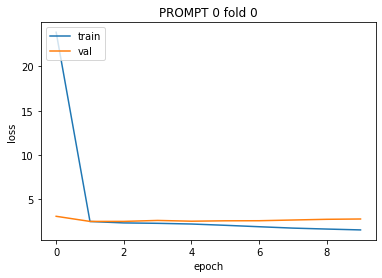


 Prompt  0  Fold  1
Epoch 1/10
38/38 [==============================] - 60s 2s/step - loss: 2.0221 - mae: 1.0406 - val_loss: 1.7800 - val_mae: 0.9700
Epoch 2/10
38/38 [==============================] - 60s 2s/step - loss: 1.8252 - mae: 0.9667 - val_loss: 1.8519 - val_mae: 0.9976
Epoch 3/10
38/38 [==============================] - 63s 2s/step - loss: 1.7208 - mae: 0.9402 - val_loss: 1.8851 - val_mae: 1.0085
Epoch 4/10
38/38 [==============================] - 61s 2s/step - loss: 1.6277 - mae: 0.9182 - val_loss: 1.9080 - val_mae: 1.0166
Epoch 5/10
38/38 [==============================] - 60s 2s/step - loss: 1.5264 - mae: 0.8811 - val_loss: 1.9460 - val_mae: 1.0288
Epoch 6/10
38/38 [==============================] - 60s 2s/step - loss: 1.5010 - mae: 0.8728 - val_loss: 1.9567 - val_mae: 1.0303
Epoch 7/10
38/38 [==============================] - 60s 2s/step - loss: 1.4571 - mae: 0.8754 - val_loss: 2.0376 - val_mae: 1.0596
Epoch 8/10
38/38 [==============================] - 60s 2s/step - los

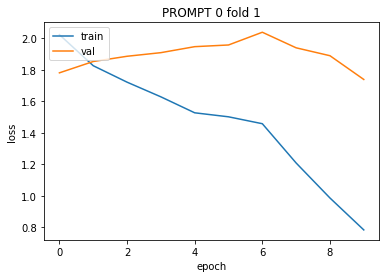


 Prompt  0  Fold  2
Epoch 1/10
38/38 [==============================] - 60s 2s/step - loss: 1.1330 - mae: 0.8073 - val_loss: 0.5479 - val_mae: 0.5945
Epoch 2/10
38/38 [==============================] - 60s 2s/step - loss: 0.8918 - mae: 0.7174 - val_loss: 0.5804 - val_mae: 0.5865
Epoch 3/10
38/38 [==============================] - 60s 2s/step - loss: 0.6958 - mae: 0.6324 - val_loss: 0.5853 - val_mae: 0.5764
Epoch 4/10
38/38 [==============================] - 60s 2s/step - loss: 0.6921 - mae: 0.6257 - val_loss: 0.8340 - val_mae: 0.7508
Epoch 5/10
38/38 [==============================] - 60s 2s/step - loss: 0.5769 - mae: 0.5684 - val_loss: 0.5030 - val_mae: 0.5396
Epoch 6/10
38/38 [==============================] - 60s 2s/step - loss: 0.4720 - mae: 0.5125 - val_loss: 0.5347 - val_mae: 0.5658
Epoch 7/10
38/38 [==============================] - 60s 2s/step - loss: 0.3861 - mae: 0.4668 - val_loss: 0.5928 - val_mae: 0.5927
Epoch 8/10
38/38 [==============================] - 60s 2s/step - los

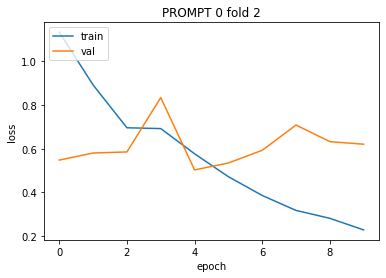

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_7 (Embedding)     (None, None, 100)         1000000   
                                                                 
 lstm_7 (LSTM)               (None, 128)               117248    
                                                                 
 dense_14 (Dense)            (None, 32)                4128      
                                                                 
 dense_15 (Dense)            (None, 1)                 33        
                                                                 
Total params: 1,121,409
Trainable params: 1,121,409
Non-trainable params: 0
_________________________________________________________________
None

 Prompt  1  Fold  0
Epoch 1/10
38/38 [==============================] - 62s 2s/step - loss: 3.7044 - mae: 1.4780 - val_loss: 0.6055 - val_mae: 0.6559
Epoch 2/10
38/38 [==

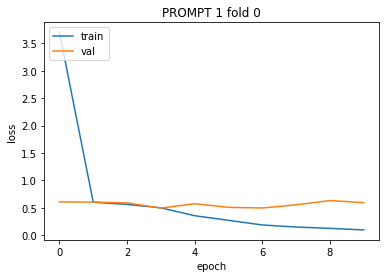


 Prompt  1  Fold  1
Epoch 1/10
38/38 [==============================] - 59s 2s/step - loss: 0.3321 - mae: 0.4355 - val_loss: 0.2108 - val_mae: 0.3675
Epoch 2/10
38/38 [==============================] - 59s 2s/step - loss: 0.1910 - mae: 0.3370 - val_loss: 0.1160 - val_mae: 0.2666
Epoch 3/10
38/38 [==============================] - 59s 2s/step - loss: 0.1257 - mae: 0.2731 - val_loss: 0.1179 - val_mae: 0.2731
Epoch 4/10
38/38 [==============================] - 59s 2s/step - loss: 0.0887 - mae: 0.2247 - val_loss: 0.1524 - val_mae: 0.3099
Epoch 5/10
38/38 [==============================] - 59s 2s/step - loss: 0.0679 - mae: 0.1989 - val_loss: 0.1484 - val_mae: 0.3010
Epoch 6/10
38/38 [==============================] - 59s 2s/step - loss: 0.0559 - mae: 0.1783 - val_loss: 0.1529 - val_mae: 0.3096
Epoch 7/10
38/38 [==============================] - 59s 2s/step - loss: 0.0503 - mae: 0.1711 - val_loss: 0.1509 - val_mae: 0.3071
Epoch 8/10
38/38 [==============================] - 60s 2s/step - los

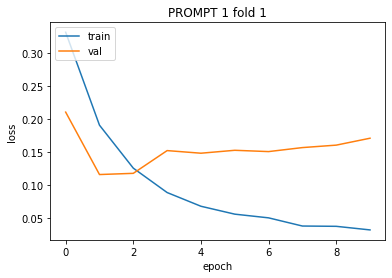


 Prompt  1  Fold  2
Epoch 1/10
38/38 [==============================] - 59s 2s/step - loss: 0.1224 - mae: 0.2640 - val_loss: 0.0342 - val_mae: 0.1422
Epoch 2/10
38/38 [==============================] - 59s 2s/step - loss: 0.0857 - mae: 0.2265 - val_loss: 0.0374 - val_mae: 0.1481
Epoch 3/10
38/38 [==============================] - 59s 2s/step - loss: 0.0558 - mae: 0.1820 - val_loss: 0.0420 - val_mae: 0.1593
Epoch 4/10
38/38 [==============================] - 59s 2s/step - loss: 0.0592 - mae: 0.1891 - val_loss: 0.0581 - val_mae: 0.1899
Epoch 5/10
38/38 [==============================] - 59s 2s/step - loss: 0.0398 - mae: 0.1546 - val_loss: 0.0415 - val_mae: 0.1589
Epoch 6/10
38/38 [==============================] - 59s 2s/step - loss: 0.0351 - mae: 0.1449 - val_loss: 0.0656 - val_mae: 0.2019
Epoch 7/10
38/38 [==============================] - 59s 2s/step - loss: 0.0284 - mae: 0.1317 - val_loss: 0.0840 - val_mae: 0.2314
Epoch 8/10
38/38 [==============================] - 59s 2s/step - los

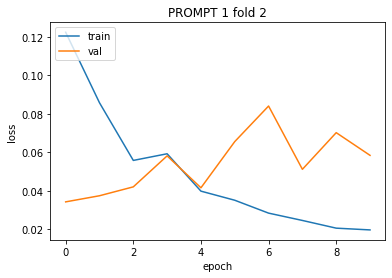

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_8 (Embedding)     (None, None, 100)         1000000   
                                                                 
 lstm_8 (LSTM)               (None, 128)               117248    
                                                                 
 dense_16 (Dense)            (None, 32)                4128      
                                                                 
 dense_17 (Dense)            (None, 1)                 33        
                                                                 
Total params: 1,121,409
Trainable params: 1,121,409
Non-trainable params: 0
_________________________________________________________________
None

 Prompt  2  Fold  0
Epoch 1/10
36/36 [==============================] - 59s 2s/step - loss: 1.4641 - mae: 0.9547 - val_loss: 0.4383 - val_mae: 0.5131
Epoch 2/10
36/36 [==

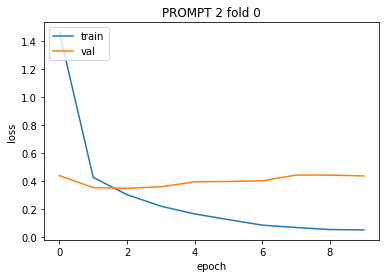


 Prompt  2  Fold  1
Epoch 1/10
36/36 [==============================] - 57s 2s/step - loss: 0.2339 - mae: 0.3543 - val_loss: 0.0896 - val_mae: 0.2301
Epoch 2/10
36/36 [==============================] - 56s 2s/step - loss: 0.1373 - mae: 0.2697 - val_loss: 0.1009 - val_mae: 0.2514
Epoch 3/10
36/36 [==============================] - 56s 2s/step - loss: 0.0919 - mae: 0.2225 - val_loss: 0.1089 - val_mae: 0.2407
Epoch 4/10
36/36 [==============================] - 56s 2s/step - loss: 0.0678 - mae: 0.1879 - val_loss: 0.1333 - val_mae: 0.2791
Epoch 5/10
36/36 [==============================] - 56s 2s/step - loss: 0.0554 - mae: 0.1757 - val_loss: 0.1177 - val_mae: 0.2587
Epoch 6/10
36/36 [==============================] - 56s 2s/step - loss: 0.0424 - mae: 0.1549 - val_loss: 0.1265 - val_mae: 0.2703
Epoch 7/10
36/36 [==============================] - 56s 2s/step - loss: 0.0341 - mae: 0.1407 - val_loss: 0.1352 - val_mae: 0.2803
Epoch 8/10
36/36 [==============================] - 57s 2s/step - los

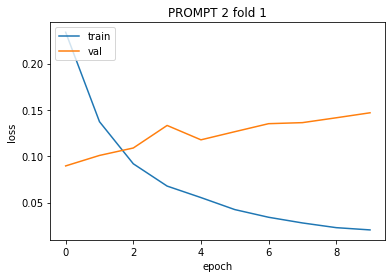


 Prompt  2  Fold  2
Epoch 1/10
36/36 [==============================] - 56s 2s/step - loss: 0.1052 - mae: 0.2380 - val_loss: 0.0276 - val_mae: 0.1248
Epoch 2/10
36/36 [==============================] - 56s 2s/step - loss: 0.0513 - mae: 0.1735 - val_loss: 0.0368 - val_mae: 0.1436
Epoch 3/10
36/36 [==============================] - 56s 2s/step - loss: 0.0361 - mae: 0.1447 - val_loss: 0.0349 - val_mae: 0.1372
Epoch 4/10
36/36 [==============================] - 56s 2s/step - loss: 0.0256 - mae: 0.1202 - val_loss: 0.0359 - val_mae: 0.1395
Epoch 5/10
36/36 [==============================] - 56s 2s/step - loss: 0.0208 - mae: 0.1082 - val_loss: 0.0395 - val_mae: 0.1454
Epoch 6/10
36/36 [==============================] - 56s 2s/step - loss: 0.0193 - mae: 0.1049 - val_loss: 0.0458 - val_mae: 0.1591
Epoch 7/10
36/36 [==============================] - 56s 2s/step - loss: 0.0201 - mae: 0.1067 - val_loss: 0.0484 - val_mae: 0.1639
Epoch 8/10
36/36 [==============================] - 56s 2s/step - los

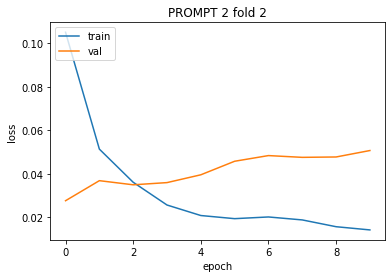

Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_9 (Embedding)     (None, None, 100)         1000000   
                                                                 
 lstm_9 (LSTM)               (None, 128)               117248    
                                                                 
 dense_18 (Dense)            (None, 32)                4128      
                                                                 
 dense_19 (Dense)            (None, 1)                 33        
                                                                 
Total params: 1,121,409
Trainable params: 1,121,409
Non-trainable params: 0
_________________________________________________________________
None

 Prompt  3  Fold  0
Epoch 1/10
37/37 [==============================] - 61s 2s/step - loss: 1.1299 - mae: 0.8220 - val_loss: 0.4031 - val_mae: 0.5004
Epoch 2/10
37/37 [==

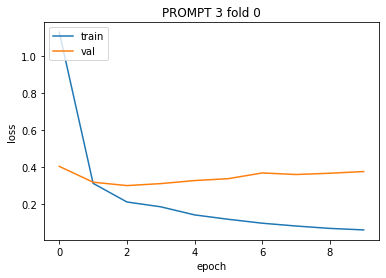


 Prompt  3  Fold  1
Epoch 1/10
37/37 [==============================] - 58s 2s/step - loss: 0.2222 - mae: 0.3443 - val_loss: 0.0685 - val_mae: 0.1989
Epoch 2/10
37/37 [==============================] - 58s 2s/step - loss: 0.1380 - mae: 0.2751 - val_loss: 0.0803 - val_mae: 0.2175
Epoch 3/10
37/37 [==============================] - 58s 2s/step - loss: 0.1021 - mae: 0.2263 - val_loss: 0.0944 - val_mae: 0.2261
Epoch 4/10
37/37 [==============================] - 58s 2s/step - loss: 0.0825 - mae: 0.2052 - val_loss: 0.1021 - val_mae: 0.2347
Epoch 5/10
37/37 [==============================] - 58s 2s/step - loss: 0.0683 - mae: 0.1833 - val_loss: 0.0999 - val_mae: 0.2420
Epoch 6/10
37/37 [==============================] - 58s 2s/step - loss: 0.0559 - mae: 0.1635 - val_loss: 0.1020 - val_mae: 0.2390
Epoch 7/10
37/37 [==============================] - 58s 2s/step - loss: 0.0439 - mae: 0.1423 - val_loss: 0.1190 - val_mae: 0.2502
Epoch 8/10
37/37 [==============================] - 58s 2s/step - los

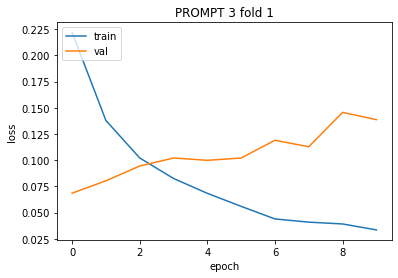


 Prompt  3  Fold  2
Epoch 1/10
37/37 [==============================] - 58s 2s/step - loss: 0.0868 - mae: 0.2068 - val_loss: 0.0390 - val_mae: 0.1325
Epoch 2/10
37/37 [==============================] - 58s 2s/step - loss: 0.0527 - mae: 0.1578 - val_loss: 0.0412 - val_mae: 0.1344
Epoch 3/10
37/37 [==============================] - 58s 2s/step - loss: 0.0367 - mae: 0.1298 - val_loss: 0.0419 - val_mae: 0.1362
Epoch 4/10
37/37 [==============================] - 58s 2s/step - loss: 0.0317 - mae: 0.1213 - val_loss: 0.0504 - val_mae: 0.1499
Epoch 5/10
37/37 [==============================] - 58s 2s/step - loss: 0.0302 - mae: 0.1204 - val_loss: 0.0740 - val_mae: 0.2007
Epoch 6/10
37/37 [==============================] - 58s 2s/step - loss: 0.0288 - mae: 0.1169 - val_loss: 0.0578 - val_mae: 0.1561
Epoch 7/10
37/37 [==============================] - 58s 2s/step - loss: 0.0221 - mae: 0.1006 - val_loss: 0.0592 - val_mae: 0.1653
Epoch 8/10
37/37 [==============================] - 58s 2s/step - los

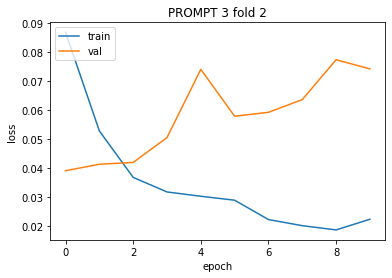

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_10 (Embedding)    (None, None, 100)         1000000   
                                                                 
 lstm_10 (LSTM)              (None, 128)               117248    
                                                                 
 dense_20 (Dense)            (None, 32)                4128      
                                                                 
 dense_21 (Dense)            (None, 1)                 33        
                                                                 
Total params: 1,121,409
Trainable params: 1,121,409
Non-trainable params: 0
_________________________________________________________________
None

 Prompt  4  Fold  0
Epoch 1/10
38/38 [==============================] - 62s 2s/step - loss: 1.8493 - mae: 1.0007 - val_loss: 0.3996 - val_mae: 0.5036
Epoch 2/10
38/38 [=

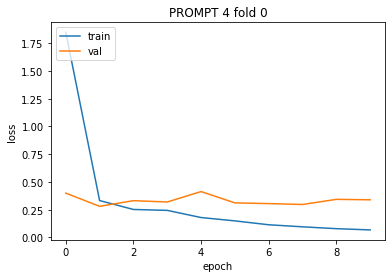


 Prompt  4  Fold  1
Epoch 1/10
38/38 [==============================] - 59s 2s/step - loss: 0.2104 - mae: 0.3484 - val_loss: 0.0769 - val_mae: 0.2061
Epoch 2/10
38/38 [==============================] - 59s 2s/step - loss: 0.1382 - mae: 0.2785 - val_loss: 0.0919 - val_mae: 0.2320
Epoch 3/10
38/38 [==============================] - 59s 2s/step - loss: 0.1079 - mae: 0.2482 - val_loss: 0.1109 - val_mae: 0.2583
Epoch 4/10
38/38 [==============================] - 59s 2s/step - loss: 0.0840 - mae: 0.2242 - val_loss: 0.1054 - val_mae: 0.2506
Epoch 5/10
38/38 [==============================] - 59s 2s/step - loss: 0.0700 - mae: 0.1994 - val_loss: 0.1142 - val_mae: 0.2567
Epoch 6/10
38/38 [==============================] - 59s 2s/step - loss: 0.0626 - mae: 0.1930 - val_loss: 0.1189 - val_mae: 0.2611
Epoch 7/10
38/38 [==============================] - 59s 2s/step - loss: 0.0526 - mae: 0.1703 - val_loss: 0.1248 - val_mae: 0.2697
Epoch 8/10
38/38 [==============================] - 59s 2s/step - los

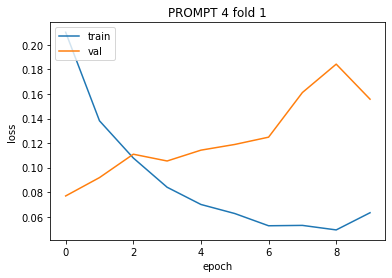


 Prompt  4  Fold  2
Epoch 1/10
38/38 [==============================] - 59s 2s/step - loss: 0.1035 - mae: 0.2404 - val_loss: 0.0445 - val_mae: 0.1674
Epoch 2/10
38/38 [==============================] - 59s 2s/step - loss: 0.0738 - mae: 0.2042 - val_loss: 0.1084 - val_mae: 0.2614
Epoch 3/10
38/38 [==============================] - 59s 2s/step - loss: 0.0732 - mae: 0.2062 - val_loss: 0.0564 - val_mae: 0.1888
Epoch 4/10
38/38 [==============================] - 59s 2s/step - loss: 0.0797 - mae: 0.2168 - val_loss: 0.0660 - val_mae: 0.2027
Epoch 5/10
38/38 [==============================] - 59s 2s/step - loss: 0.0547 - mae: 0.1767 - val_loss: 0.0603 - val_mae: 0.1946
Epoch 6/10
38/38 [==============================] - 59s 2s/step - loss: 0.0409 - mae: 0.1518 - val_loss: 0.0631 - val_mae: 0.1966
Epoch 7/10
38/38 [==============================] - 59s 2s/step - loss: 0.0395 - mae: 0.1503 - val_loss: 0.0678 - val_mae: 0.2060
Epoch 8/10
38/38 [==============================] - 60s 2s/step - los

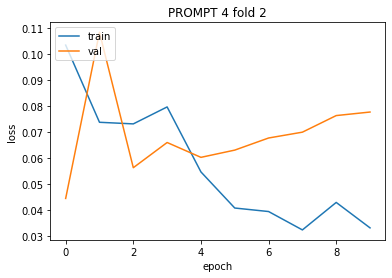

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 embedding_11 (Embedding)    (None, None, 100)         1000000   
                                                                 
 lstm_11 (LSTM)              (None, 128)               117248    
                                                                 
 dense_22 (Dense)            (None, 32)                4128      
                                                                 
 dense_23 (Dense)            (None, 1)                 33        
                                                                 
Total params: 1,121,409
Trainable params: 1,121,409
Non-trainable params: 0
_________________________________________________________________
None

 Prompt  5  Fold  0
Epoch 1/10
38/38 [==============================] - 62s 2s/step - loss: 2.5786 - mae: 1.2324 - val_loss: 0.9489 - val_mae: 0.8221
Epoch 2/10
38/38 [=

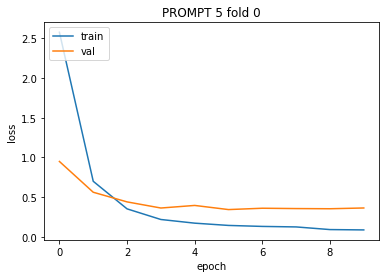


 Prompt  5  Fold  1
Epoch 1/10
38/38 [==============================] - 59s 2s/step - loss: 0.2578 - mae: 0.3939 - val_loss: 0.1199 - val_mae: 0.2684
Epoch 2/10
38/38 [==============================] - 59s 2s/step - loss: 0.1514 - mae: 0.3023 - val_loss: 0.0914 - val_mae: 0.2374
Epoch 3/10
38/38 [==============================] - 59s 2s/step - loss: 0.1332 - mae: 0.2850 - val_loss: 0.0978 - val_mae: 0.2502
Epoch 4/10
38/38 [==============================] - 59s 2s/step - loss: 0.1042 - mae: 0.2513 - val_loss: 0.1081 - val_mae: 0.2544
Epoch 5/10
38/38 [==============================] - 59s 2s/step - loss: 0.0850 - mae: 0.2240 - val_loss: 0.1068 - val_mae: 0.2512
Epoch 6/10
38/38 [==============================] - 59s 2s/step - loss: 0.0728 - mae: 0.2026 - val_loss: 0.1070 - val_mae: 0.2543
Epoch 7/10
38/38 [==============================] - 59s 2s/step - loss: 0.0619 - mae: 0.1861 - val_loss: 0.1213 - val_mae: 0.2690
Epoch 8/10
38/38 [==============================] - 59s 2s/step - los

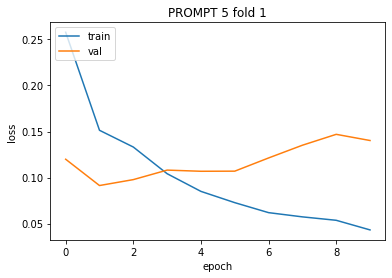


 Prompt  5  Fold  2
Epoch 1/10
38/38 [==============================] - 59s 2s/step - loss: 0.1001 - mae: 0.2377 - val_loss: 0.0409 - val_mae: 0.1577
Epoch 2/10
38/38 [==============================] - 59s 2s/step - loss: 0.0700 - mae: 0.2013 - val_loss: 0.0374 - val_mae: 0.1422
Epoch 3/10
38/38 [==============================] - 59s 2s/step - loss: 0.0644 - mae: 0.1912 - val_loss: 0.0446 - val_mae: 0.1601
Epoch 4/10
38/38 [==============================] - 59s 2s/step - loss: 0.0528 - mae: 0.1717 - val_loss: 0.0477 - val_mae: 0.1609
Epoch 5/10
38/38 [==============================] - 59s 2s/step - loss: 0.0414 - mae: 0.1512 - val_loss: 0.0739 - val_mae: 0.2092
Epoch 6/10
38/38 [==============================] - 59s 2s/step - loss: 0.0349 - mae: 0.1366 - val_loss: 0.0526 - val_mae: 0.1727
Epoch 7/10
38/38 [==============================] - 59s 2s/step - loss: 0.0346 - mae: 0.1373 - val_loss: 0.0553 - val_mae: 0.1769
Epoch 8/10
38/38 [==============================] - 59s 2s/step - los

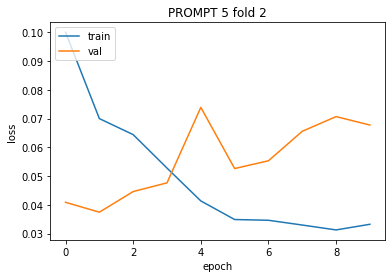

all done


In [ ]:
dataset=[]
#df=train_score
idx=0
MAX_SEQUENCE_LENGTH=500

for i in range(0,7):
  dataset.append(df[df.essay_set==i+1].rename(columns={"domain1_score":"score"}).loc[:,["corpus","score"]])
#dataset.append(df[df.essay_set==2].rename(columns={"domain2_score":"score"}).loc[:,["corpus","score"]])
# Create tokenizers (objects that convert text to vectors) and sequence vectors
# For each prompt separately

tokenizer = []
sequences=[]
labels=[]
for prompt in range(0,7):
  tokenizer_curr=Tokenizer() 
  tokenizer_curr.fit_on_texts(dataset[prompt].essay) 
  sequence_curr=tokenizer_curr.texts_to_sequences(dataset[prompt].essay)
  word_index = tokenizer_curr.word_index   
  #print('Found ',len(word_index),' unique tokens for prompt ' ,prompt, ' With ',len(sequence_curr),' essays, and the maximum string length being ',max([len(i) for i in sequence_curr]))
  sequence_curr = pad_sequences(sequence_curr, maxlen=MAX_SEQUENCE_LENGTH)
  
  tokenizer.append(tokenizer_curr)
  sequences.append(sequence_curr)
  labels.append(np.asarray(dataset[prompt].score))

model=[]
history=[]
MAX_NUM_WORDS=10000 
EMBEDDING_DIM=100
for prompt in range(0,7):
  rnnmodel = Sequential()
  rnnmodel.add(Embedding(MAX_NUM_WORDS, EMBEDDING_DIM))
  rnnmodel.add(LSTM(128, dropout=0.2, recurrent_dropout=0.2))
  rnnmodel.add(Dense(32, activation='relu'))
  rnnmodel.add(Dense(1, activation='relu'))
  rnnmodel.compile(loss='mean_squared_error',
              optimizer='adam',
              metrics=['mae'])
  print(rnnmodel.summary())
  fold=0
  for train_index, test_index in KFold(3,shuffle=True).split(sequences[prompt]):
    print('\n Prompt ',prompt,' Fold ',fold)
    x_train, x_val = sequences[prompt][train_index], sequences[prompt][test_index]
    y_train, y_val = labels[prompt][train_index], labels[prompt][test_index]
    his=rnnmodel.fit(x_train, y_train,
            batch_size=32,
            epochs=10,
            validation_data=(x_val, y_val))
    
    #path = "/content/gdrive/My Drive/aes_born_"+str(prompt)+".h5" 
    #rnnmodel.save(path)

    plt.plot(his.history['loss'])
    plt.plot(his.history['val_loss'])
    plt.title('PROMPT '+str(prompt)+' fold '+str(fold))
    plt.ylabel('loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    plt.show()
  
    history.append(his)
    fold+=1

    # summarize history for loss

  model.append(rnnmodel)

print('all done')

### for train data

In [ ]:
dataset=[]
idx=0
MAX_SEQUENCE_LENGTH=500

for i in range(0,8):
  dataset.append(df[df.essay_set==i+1].rename(columns={"domain1_score":"score"}).loc[:,["essay_set","essay_id","corpus","score"]])
dataset.append(df[df.essay_set==2].rename(columns={"domain2_score":"score"}).loc[:,["essay_set","essay_id","corpus","score"]])
# Create tokenizers (objects that convert text to vectors) and sequence vectors
# For each prompt separately

sequences=[]
answers=[]
for prompt in range(0,9):
  sequence_curr=tokenizer[prompt].texts_to_sequences(dataset[prompt].corpus)
  sequence_curr = pad_sequences(sequence_curr, maxlen=MAX_SEQUENCE_LENGTH)
  answer=model[prompt].predict(sequence_curr)
  answers.append(answer)
  dataset[prompt]['Predicted_score'] = answer.tolist()
  dataset[prompt]['Predicted_score'] = dataset[prompt]['Predicted_score'].apply(lambda x: round(x[0],0))


my_submission=pd.concat(dataset)
my_submission=my_submission[["essay_set","essay_id","score","Predicted_score"]]
my_submission.to_csv('train_predicted_score.csv', index=False)

df2=my_submission
df1=df
df3=pd.merge(df1, df2, left_on='essay_id', right_on='essay_id')

fileout="/content/gdrive/My Drive/Out/EMBtrain_predicted_score.csv"
pd.DataFrame(df2).to_csv(fileout)

#df3=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
train_QWK=sklearn_qwk(df2['score'], df2['Predicted_score'])
train_QWK

#For validation data
print(validation_all.head())
validation_all['corpus']=validation_all.essay.apply(lambda x: cleaner(x))
validation_all.head()

dataset=[]
idx=0
MAX_SEQUENCE_LENGTH=500

for i in range(0,6):
  dataset.append(validation_all[validation_all.essay_set==i+1].rename(columns={"domain1_predictionid":"id","domain1_score":"score"}).loc[:,["essay_set","id","corpus","score"]])
#dataset.append(validation_all[validation_all.essay_set==2].rename(columns={"domain2_predictionid":"id","domain2_score":"score"}).loc[:,["essay_set","id","corpus","score"]])
# Create tokenizers (objects that convert text to vectors) and sequence vectors
# For each prompt separately

sequences=[]
answers=[]
for prompt in range(0,7):
  sequence_curr=tokenizer[prompt].texts_to_sequences(dataset[prompt].corpus)
  sequence_curr = pad_sequences(sequence_curr, maxlen=MAX_SEQUENCE_LENGTH)
  answer=model[prompt].predict(sequence_curr)
  answers.append(answer)
  dataset[prompt]['Predicted_score'] = answer.tolist()
  dataset[prompt]['Predicted_score'] = dataset[prompt]['Predicted_score'].apply(lambda x: round(x[0],0))

my_submission=pd.concat(dataset)
my_submission=my_submission[["essay_set","id","score","Predicted_score"]]

for i in range(0,6):
  validation_all[validation_all.essay_set==i+1].rename(columns={"domain1_predictionid":"id"})
                                                       
validation_all[validation_all.essay_set==2].rename(columns={"domain2_predictionid":"id"}  )

df2=my_submission

fileout="/content/gdrive/My Drive/Out/EMBvalidation_predicted_score.csv"
pd.DataFrame(df2).to_csv(fileout)

#df3=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
validation_QWK=sklearn_qwk(df2['score'], df2['Predicted_score'])
validation_QWK

   essay_id_x  essay_set_x                                              essay  \
0        1788            1  Dear @ORGANIZATION1, @CAPS1 more and more peop...   
1        1789            1  Dear @LOCATION1 Time @CAPS1 me tell you what I...   
2        1790            1  Dear Local newspaper, Have you been spending a...   
3        1791            1  Dear Readers, @CAPS1 you imagine how life woul...   
4        1792            1  Dear newspaper, I strongly believe that comput...   

   domain1_predictionid  domain2_predictionid  prediction_id  essay_id_y  \
0                  1788                   NaN           1788        1788   
1                  1789                   NaN           1789        1789   
2                  1790                   NaN           1790        1790   
3                  1791                   NaN           1791        1791   
4                  1792                   NaN           1792        1792   

   essay_set_y  essay_weight  predicted_score  domain1_s

(-0.26621348695846425, -0.18339726676668477)

In [ ]:
train_QWK,validation_QWK=0.7674252111640862, 0.7730140030443906

(0.7674252111640862, 0.7730140030443906)

In [ ]:
#For validation data
print(validation_all.head())
validation_all['corpus']=validation_all.essay.apply(lambda x: cleaner(x))
validation_all.head()

dataset=[]
idx=0
MAX_SEQUENCE_LENGTH=500

for i in range(0,8):
  dataset.append(validation_all[validation_all.essay_set==i+1].rename(columns={"domain1_predictionid":"id","domain1_score":"score"}).loc[:,["essay_set","id","corpus","score"]])
#dataset.append(validation_all[validation_all.essay_set==2].rename(columns={"domain2_predictionid":"id","domain2_score":"score"}).loc[:,["essay_set","id","corpus","score"]])
# Create tokenizers (objects that convert text to vectors) and sequence vectors
# For each prompt separately

sequences=[]
answers=[]
for prompt in range(0,8):
  sequence_curr=tokenizer[prompt].texts_to_sequences(dataset[prompt].corpus)
  sequence_curr = pad_sequences(sequence_curr, maxlen=MAX_SEQUENCE_LENGTH)
  answer=model[prompt].predict(sequence_curr)
  answers.append(answer)
  dataset[prompt]['Predicted_score'] = answer.tolist()
  dataset[prompt]['Predicted_score'] = dataset[prompt]['Predicted_score'].apply(lambda x: round(x[0],0))

my_submission=pd.concat(dataset)
my_submission=my_submission[["essay_set","id","score","Predicted_score"]]

for i in range(0,8):
  validation_all[validation_all.essay_set==i+1].rename(columns={"domain1_predictionid":"id"})
                                                       
validation_all[validation_all.essay_set==2].rename(columns={"domain2_predictionid":"id"}  )

df2=my_submission

fileout="/content/gdrive/My Drive/Out/EMBvalidation_predicted_score.csv"
pd.DataFrame(df2).to_csv(fileout)

#df3=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
validation_QWK=sklearn_qwk(df2['score'], df2['Predicted_score'])
validation_QWK

###For test data

In [ ]:
print(test_all.head())
test_all['corpus']=test_all.essay.apply(lambda x: cleaner(x))
test_all.head()
dataset=[]
idx=0
MAX_SEQUENCE_LENGTH=500

for i in range(0,8):
  dataset.append(test_all[test_all.essay_set==i+1].rename(columns={"domain1_predictionid":"id"}).loc[:,["essay_set","id","corpus"]])
#dataset.append(test_all[test_all.essay_set==2].rename(columns={"domain2_predictionid":"id"}).loc[:,["essay_set","id","corpus"]])
# Create tokenizers (objects that convert text to vectors) and sequence vectors
# For each prompt separately

sequences=[]
answers=[]
for prompt in range(0,8):
  sequence_curr=tokenizer[prompt].texts_to_sequences(dataset[prompt].corpus)
  sequence_curr = pad_sequences(sequence_curr, maxlen=MAX_SEQUENCE_LENGTH)
  answer=model[prompt].predict(sequence_curr)
  answers.append(answer)
  dataset[prompt]['Predicted_score'] = answer.tolist()
  dataset[prompt]['Predicted_score'] = dataset[prompt]['Predicted_score'].apply(lambda x: round(x[0],0))

my_submission=pd.concat(dataset)
my_submission=my_submission[["essay_set","id","Predicted_score"]]
fileout="/content/gdrive/My Drive/Out/EMBtest_predicted_score.csv"
pd.DataFrame(my_submission).to_csv(fileout)
my_submission.to_csv('test_predicted_score.csv', index=False)
my_submission.head()  

   essay_id  essay_set  ... avg_word_length  Nessay_set
0      2383          1  ...        0.079179   -1.475922
1      2384          1  ...        0.627533   -1.475922
2      2385          1  ...        0.051761   -1.475922
3      2386          1  ...        0.764621   -1.475922
4      2387          1  ...        0.517862   -1.475922

[5 rows x 15 columns]


IndexError: ignored

# Others

In [ ]:
from numpy import loadtxt
from keras.models import Sequential
from keras.layers import Dense
train_txt=train_score
validation_txt=validation_score
test_txt=test_score
tX, tY,vX, vY,tsX=PreModel(train_txt,validation_txt,test_txt,train_dat, validation_dat,test_dat, colname, STOPWORDS,TF_IDF=True, Label="domain1_score")
mdel="RNN"
MAX_NUM_WORDS=10000 
EMBEDDING_DIM=1009
rnnmodel = Sequential()
rnnmodel.add(Embedding(MAX_NUM_WORDS, EMBEDDING_DIM))
rnnmodel.add(LSTM(128, dropout=0.2, recurrent_dropout=0.2))
rnnmodel.add(Dense(32, activation='relu'))
rnnmodel.add(Dense(1, activation='relu'))
rnnmodel.compile(loss='mean_squared_error',
              optimizer='adam',
              metrics=['mae'])
print(rnnmodel.summary())
#tX=pd.DataFrame(tX)
#tY=pd.DataFrame(tY)
#vX=pd.DataFrame(vX)
#vY=pd.DataFrame(vY)
#tsX=pd.DataFrame(tsX)
sequence_curr = pad_sequences(tX, maxlen=EMBEDDING_DIM)
#a list of np.array of dataframe shape
history_ffn = rnnmodel.fit(tX, tY, epochs=10, batch_size=32,validation_data=(vX, vY))
_, train_scores_ffn=rnn.model.evaluate(tX, tY)
#validation_scores_ffn=model_ffn.evaluate(vX, vY, verbose=0)
#_, accuracy = model.evaluate(tX, tY)
train_predicted = (mrnn.model.predict(tX) > 0.5).astype(int)
validation_predicted = (rnn.model.predict(vX) > 0.5).astype(int)
test_predicted = (rnn.model.predict(tsX) > 0.5).astype(int)


df2=pd.DataFrame(train_predicted,columns=['Predicted_score'])
df1=train_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
#train_QWK=sklearn_qwk(df['score'], df['Predicted_score'])
train_QWK=sklearn_qwk(np.asarray(df['domain1_score'], dtype=int),np.asarray(df['Predicted_score'], dtype=int))
fileout="/content/gdrive/My Drive/Out/train_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)

df2=pd.DataFrame(np.rint(validation_predicted),columns=['Predicted_score'])
df1=validation_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/Out/validation_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
validation_QWK=sklearn_qwk(np.asarray(df['domain1_score'], dtype=int),np.asarray(df['Predicted_score'], dtype=int))

df2=pd.DataFrame(np.rint(test_predicted),columns=['Predicted_score'])
df1=test_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/Out/test_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
_, LGRRate_validation_score=rnn.model.evaluate(vX, vY)
_, LGRRate_train_score=rnn.model.evaluate(tX, tY)


result=np.array([LGRRate_train_score, LGRRate_validation_score,train_QWK,validation_QWK]) #0.99,0.49
result=pd.DataFrame(result)
result=result.transpose()
result.columns =['train_score','validation_score','train_QWK','validation_QWK']
fileout="/content/gdrive/My Drive/Out/"+mdel+"_result.csv"
pd.DataFrame(result).to_csv(fileout)



In [ ]:
df2=pd.DataFrame(np.rint(train_predicted),columns=['Predicted_score'])
df1=train_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
train_QWK=sklearn_qwk(df['score'], df['Predictedscore'])
fileout="/content/gdrive/My Drive/Out/train_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)

df2=pd.DataFrame(np.rint(validation_predicted),columns=['Predicted_Domain1_score'])
df1=validation_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/Out/validation_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)

In [ ]:
from numpy import loadtxt
from keras.models import Sequential
from keras.layers import Dense
# split into input (X) and output (y) variables
#tX, tY,vX, vY,tsX
# define the keras model
model = Sequential()
model.add(Dense(12, input_dim=1009, activation='relu'))
model.add(Dense(8, activation='relu'))
model.add(Dense(1, activation='sigmoid'))
print(model.summary())
# compile the keras model
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
# fit the keras model on the dataset
tYy=np.array(tY)
vYy=np.array(vY)
model.fit(tX, tYy, epochs=150, batch_size=10)
# evaluate the keras model
model.predict(tX,tYy)
_, accuracy = model.evaluate(tX, tYy)
print('Accuracy: %.2f' % (accuracy*100))



In [ ]:
from sklearn.metrics import classification_report, confusion_matrix #Import scikit-learn metrics module for accuracy calculation

y_pred=model.predict(vX)
_, accuracy = model.evaluate(vX, vYy)
print('Accuracy: %.2f' % (accuracy*100))

cm = confusion_matrix(vYy, y_pred)
plt.figure(figsize=(5,5))
sns.heatmap(data=cm,linewidths=.5, annot=True,square = True,  cmap = 'Blues')
plt.ylabel('Actual label')
plt.xlabel('Predicted label')
all_sample_title = 'Accuracy Score: {0}'.format(accuracy)
plt.title(all_sample_title, size = 15)


In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import plot_confusion_matrix
from sklearn.metrics import classification_report
print(grid.best_params_) 
train_predicted = grid.predict(tX) 
validation_predicted = grid.predict(vX) 
train_score_result=grid.score(tX,list(tY))
test_score_result=grid.score(vX,list(vY))

print('Train Accuracy: {:.2f}'.format(accuracy_score(tY, train_predicted)))
print('Validation Accuracy: {:.2f}'.format(accuracy_score(vY, validation_predicted)))
train_score_result, test_score_result

In [ ]:
from sklearn.model_selection import train_test_split

def NTrainTest(train_txt,name,test_txt,state=100,Label='label'):
  #tY=train_txt['sentiment']
  X_scale=train_txt[name]
  Y=train_txt[Label] #domain1_score
  X_train, X_val, Y_train, Y_val = train_test_split(X_scale, Y, random_state=state, test_size=0.2)
  trY=Y_train
  trY=trY.tolist()
  trTxt=X_train
  vY=Y_val
  vY=vY.tolist()
  vTxt=X_val

  #tsY=test_txt[Label]
  #vTxt=test_txt[name]
  tsTxt=pd.Series(test_dat)
  #tsY=vY.tolist()

  vY= Y_val
  vTxt=X_val
  vY=vY.tolist()


  return trTxt, trY, vTxt, vY,tsTxt


In [ ]:
def NPreModel(train_txt,test_txt, train_dat,test_dat, colname,stopword_list,TF_IDF=True,state=100, Label='label'):
  #stopword_list = nltk.corpus.stopwords.words('english')
  tTxt, tY, vTxt, vY,tsTxt= NTrainTest(train_txt,colname,test_txt, state,Label)
  CntVec=CountVectorizer(stop_words=stopword_list,token_pattern=r'(?u)\b\w+\b', lowercase=True, max_features=1000)
  tX = CntVec.fit_transform(tTxt.values.astype('U')) 
  vX = CntVec.transform(vTxt.values.astype('U')) 
  tsX = CntVec.transform(tsTxt.values.astype('U')) 
  if TF_IDF:
    tfidf_transformer=TfidfTransformer(smooth_idf=True,use_idf=True)
    tX=tfidf_transformer.fit_transform(tX)
    vX=tfidf_transformer.transform(vX)
    tsX=tfidf_transformer.transform(tsX)
  column_names=CntVec.get_feature_names()
  tX=tX.toarray()
  vX=vX.toarray()
  tsX=tsX.toarray()
  tX = pd.DataFrame(tX, columns=column_names)
  vX = pd.DataFrame(vX, columns=column_names)
  tsX = pd.DataFrame(tsX, columns=column_names)
  df2=pd.DataFrame(tTxt[colname].values)
  df1=tX
  tX=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)

  df2=pd.DataFrame(v_Txt[colname].values)
  df1=vX
  vX=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
   
  df2=pd.DataFrame(test_txt[colname].values)
  df1=tsX
  tsX=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
 
  return tX,tY, vX,vY,tsX

#stopword_list = nltk.corpus.stopwords.words('english')
#PreModel(train_txt,test_txt, stopword_list,'Rake_Extracted')


In [ ]:
#Logistic regression using Rake_extracted
def NML(model, train_txt, test_txt, train_dat,test_dat,colname,stopword_list, TF_IDF=True, state=100,Label='label'):
  tX, tY,vX, vY,tsX=NPreModel(train_txt,test_txt,train_dat, test_dat, colname, stopword_list,TF_IDF, state, Label)
  if (model=='LRG'):
    para_seed = [(c, iter) for c in np.linspace(.01, 5, num=100) for iter in np.linspace(10, 500, num=50)]
    lvc_df = pd.DataFrame(para_seed, columns=['c', 'iter'])
    lvc_df['model'] =  lvc_df.apply(lambda row: LogisticRegression(n_jobs=-1, C=row.c, max_iter=row.iter).fit(tX, list(tY)), axis=1)
    #lvc_df['score'] = lvc_df['model'].apply(lambda model: model.score(vX, list(vY)))
  if (model=='Lasso'):
    para_seed = [(c, iter) for c in np.linspace(0, 50, num=100) for iter in np.linspace(10, 500, num=50)]
    lvc_df = pd.DataFrame(para_seed, columns=['c', 'iter'])
    lvc_df['model'] =  lvc_df.apply(lambda row: Lasso(alpha=row.c, max_iter=row.iter).fit(tX, list(tY)), axis=1)
    #lvc_df['score'] = lvc_df['model'].apply(lambda model: model.score(vX, list(vY)))
  if (model=='SVC'):
    c_seed = np.linspace(600, 3000, num=100)
    lvc_df = pd.DataFrame(c_seed, columns=['c'])
    lvc_df['model'] =  lvc_df.apply(lambda c: svm.SVC(kernel='rbf',C=c,gamma='auto').fit(tX, list(tY)), axis=1)
  if (model=='LVC'):
    c_seed = np.linspace(.05, 2, num=100)
    lvc_df = pd.DataFrame(c_seed, columns=['c'])
    lvc_df['model'] = lvc_df['c'].apply(lambda c: LinearSVC(C=c).fit(tX, list(tY)))
    #lvc_df['score'] = lvc_df['model'].apply(lambda model: model.score(TvX, list(vY)))

  if (model=='RF'):
    n_estimators = range(10, 500,100)
    lvc_df = pd.DataFrame(n_estimators, columns=['c'])
    lvc_df['model']=lvc_df['c'].apply(lambda c: RandomForestClassifier(n_estimators=c).fit(tX, list(tY)))
  if (model=='NB'):
    alphas = np.linspace(.1, 100, num=100)
    lvc_df = pd.DataFrame(alphas, columns=['c'])
    lvc_df['model'] = lvc_df['c'].apply(lambda c: GaussianNB(alpha=c).fit(tX, list(tY)))
  if (model=='ANN'):
    parameter_space = {
    'hidden_layer_sizes': [(50,50,50), (50,100,50), (100,)],
    'activation': ['tanh', 'relu'],
    'solver': ['sgd', 'adam'],
    'alpha': [0.0001, 0.05],
    'learning_rate': ['constant','adaptive'],
    }
    alphas = np.linspace(1, 2, num=2)
    lvc_df = pd.DataFrame(alphas, columns=['c'])
    #lvc_df['model'] = lvc_df['c'].apply(lambda c: MLPClassifier(solver='adam', alpha=c, learning_rate='adaptive',hidden_layer_sizes=(1000, )).fit(tX, tY))
    lvc_df['model'] = lvc_df['c'].apply(lambda c: MLPClassifier(solver='adam', activation='relu',max_iter = 500,alpha=c, learning_rate='adaptive',hidden_layer_sizes=(150,100, 50)).fit(tX, tY))

  lvc_df['score']=lvc_df['model'].apply(lambda model: model.score(vX, list(vY)))
  filter=lvc_df['score']==max(lvc_df['score'])
  bestmodel=lvc_df[filter]['model'].values[0]
  train_score_result=bestmodel.score(tX,list(tY))
  test_score_result=bestmodel.score(vX,list(vY))

  test_predicted=bestmodel.predict(tsX)
  train_predicted=bestmodel.predict(tX)
  validation_predicted=bestmodel.predict(vX)
  
  return bestmodel, train_score_result, test_score_result,tsX,train_predicted,validation_predicted,test_predicted
  #return max(lvc_df['score'])

In [ ]:
def PreModel(train_txt,validation_txt,test_txt, train_dat, validation_dat,test_dat, colname,stopword_list,TF_IDF=True, Label='label'):
  #stopword_list = nltk.corpus.stopwords.words('english')
  tTxt, tY, tX_row_names, vTxt, vY, vX_row_names,tsTxt, tsX_row_names= TrainTest(train_txt,validation_txt, test_txt,train_dat, validation_dat,test_dat,Label)
  CntVec=CountVectorizer(stop_words=stopword_list,token_pattern=r'(?u)\b\w+\b', lowercase=True, max_features=1000)
  tX = CntVec.fit_transform(tTxt.values.astype('U')) 
  vX = CntVec.transform(vTxt.values.astype('U')) 
  tsX = CntVec.transform(tsTxt.values.astype('U')) 
  if TF_IDF:
    tfidf_transformer=TfidfTransformer(smooth_idf=True,use_idf=True)
    tX=tfidf_transformer.fit_transform(tX)
    vX=tfidf_transformer.transform(vX)
    tsX=tfidf_transformer.transform(tsX)
  column_names=CntVec.get_feature_names()
  tX=tX.toarray()
  vX=vX.toarray()
  tsX=tsX.toarray()
  tX = pd.DataFrame(tX, columns=column_names, index=tX_row_names)
  vX = pd.DataFrame(vX, columns=column_names, index=vX_row_names)
  tsX = pd.DataFrame(tsX, columns=column_names, index=tsX_row_names)
  df2=pd.DataFrame(train_txt[colname].values)
  df1=pd.DataFrame(tX)
  tX=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)

  df2=pd.DataFrame(validation_txt[colname].values)
  df1=pd.DataFrame(vX)
  vX=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
   
  df2=pd.DataFrame(test_txt[colname].values)
  df1=pd.DataFrame(tsX)
  tsX=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
 
  return tX,tY, vX,vY,tsX


In [ ]:
mdel="FFN"
#colname=['Nessay_set', 'FleschScore', 'smog_index', 'difficult_words','avg_sentence_length', 'spache_readability']
colname=['Nessay_set', 'FleschScore', 'smog_index', 'difficult_words','avg_sentence_length', 'spache_readability','automated_readability_index','total_words','avg_sentence_length']
train_txt=train_score
validation_txt=validation_score
test_txt=test_score
stopword_list=STOPWORDS
TF_IDF=True
Label="domain1_score"
tTxt, tY, tX_row_names, vTxt, vY, vX_row_names,tsTxt, tsX_row_names= TrainTest(train_txt,validation_txt, test_txt,train_dat, validation_dat,test_dat,Label)
CntVec=CountVectorizer(stop_words=stopword_list,token_pattern=r'(?u)\b\w+\b', lowercase=True, max_features=1000)
tX = CntVec.fit_transform(tTxt.values.astype('U')) 
vX = CntVec.transform(vTxt.values.astype('U')) 
tsX = CntVec.transform(tsTxt.values.astype('U')) 
if TF_IDF:
  tfidf_transformer=TfidfTransformer(smooth_idf=True,use_idf=True)
  tX=tfidf_transformer.fit_transform(tX)
  vX=tfidf_transformer.transform(vX)
  tsX=tfidf_transformer.transform(tsX)
column_names=CntVec.get_feature_names()
tX=tX.toarray()
vX=vX.toarray()
tsX=tsX.toarray()

/usr/local/lib/python3.7/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function get_feature_names is deprecated; get_feature_names is deprecated in 1.0 and will be removed in 1.2. Please use get_feature_names_out instead.
  warnings.warn(msg, category=FutureWarning)


In [ ]:
tX[1]

In [ ]:
# Fully connected neural network
#2/27/22
mdel="FFN"
#colname=['Nessay_set', 'FleschScore', 'smog_index', 'difficult_words','avg_sentence_length', 'spache_readability']
colname=['Nessay_set', 'FleschScore', 'smog_index', 'difficult_words','avg_sentence_length', 'spache_readability','automated_readability_index','total_words','avg_sentence_length']
train_txt=train_score
validation_txt=validation_score
test_txt=test_score
stopword_list=STOPWORDS
TF_IDF=True
tTxt, tY, tX_row_names, vTxt, vY, vX_row_names,tsTxt, tsX_row_names= TrainTest(train_txt,validation_txt, test_txt,train_dat, validation_dat,test_dat,Label)
CntVec=CountVectorizer(stop_words=stopword_list,token_pattern=r'(?u)\b\w+\b', lowercase=True, max_features=1000)
tX = CntVec.fit_transform(tTxt.values.astype('U')) 
vX = CntVec.transform(vTxt.values.astype('U')) 
tsX = CntVec.transform(tsTxt.values.astype('U')) 
if TF_IDF:
  tfidf_transformer=TfidfTransformer(smooth_idf=True,use_idf=True)
  tX=tfidf_transformer.fit_transform(tX)
  vX=tfidf_transformer.transform(vX)
  tsX=tfidf_transformer.transform(tsX)
column_names=CntVec.get_feature_names()
tX=tX.toarray()vX=vX.toarray()
tsX=tsX.toarray()


max_review_length = 1009
vocabulary_size = 10000
embedding_dim=100#  
model_ffn = Sequential()
model_ffn.add(Dense(2000, activation='relu',input_dim=max_review_length)) #250
model_ffn.add(Dense(2000, activation='relu'))
model_ffn.add(Dense(2000, activation='relu'))
model_ffn.add(Dense(1, activation='sigmoid'))
model_ffn.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
#history_ffn=model_ffn.fit(tX, tY, epochs=150, batch_size=10)
tX=pd.DataFrame(tX)
tY=pd.DataFrame(tY)
vX=pd.DataFrame(vX)
vY=pd.DataFrame(vY)
tsX=pd.DataFrame(tsX)
history_ffn = model_ffn.fit(tX, tY, epochs=10, batch_size=32,validation_data=(vX, vY))
_, train_scores_ffn=model_ffn.evaluate(tX, tY)
#validation_scores_ffn=model_ffn.evaluate(vX, vY, verbose=0)
#_, accuracy = model.evaluate(tX, tY)
train_predicted = (model_ffn.predict(tX) > 0.5).astype(int)
validation_predicted = (model_ffn.predict(vX) > 0.5).astype(int)
test_predicted = (model_ffn.predict(tsX) > 0.5).astype(int)


df2=pd.DataFrame(train_predicted,columns=['Predicted_score'])
df1=train_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
#train_QWK=sklearn_qwk(df['score'], df['Predicted_score'])
train_QWK=sklearn_qwk(np.asarray(df['domain1_score'], dtype=int),np.asarray(df['Predicted_score'], dtype=int))
fileout="/content/gdrive/My Drive/Out/train_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)

df2=pd.DataFrame(np.rint(validation_predicted),columns=['Predicted_score'])
df1=validation_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/Out/validation_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
validation_QWK=sklearn_qwk(np.asarray(df['domain1_score'], dtype=int),np.asarray(df['Predicted_score'], dtype=int))

df2=pd.DataFrame(np.rint(test_predicted),columns=['Predicted_score'])
df1=test_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/Out/test_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
_, LGRRate_validation_score=model_ffn.evaluate(vX, vY)
_, LGRRate_train_score=model_ffn.evaluate(tX, tY)


result=np.array([LGRRate_train_score, LGRRate_validation_score,train_QWK,validation_QWK]) #0.99,0.49
result=pd.DataFrame(result)
result=result.transpose()
result.columns =['train_score','validation_score','train_QWK','validation_QWK']
fileout="/content/gdrive/My Drive/Out/"+mdel+"_result.csv"
pd.DataFrame(result).to_csv(fileout)



In [ ]:
_, LGRRate_validation_score=model_ffn.evaluate(vX, vY)
_, LGRRate_train_score=model_ffn.evaluate(tX, tY)


result=np.array([LGRRate_train_score, LGRRate_validation_score,train_QWK,validation_QWK]) #0.99,0.49
result=pd.DataFrame(result)
result=result.transpose()
result.columns =['train_score','validation_score','train_QWK','validation_QWK']
fileout="/content/gdrive/My Drive/Out/"+mdel+"_result.csv"
pd.DataFrame(result).to_csv(fileout)


406/406 [==============================] - 8s 19ms/step - loss: 114.1102 - mae: 5.8647


In [ ]:
colname=['FleschScore', 'smog_index', 'difficult_words','avg_sentence_length', 'spache_readability']
LRGRate_model, LGRRate_train_score, LGRRate_test_score,txX,train_predicted, validation_predicted, test_predicted=ML('Lasso', train_score, validation_score,test_score, train_dat,validation_dat,test_dat,colname,STOPWORDS,TF_IDF=True, Label='domain1_score')

df2=pd.DataFrame(train_predicted,columns=['Predicted_Domain1_score'])
df1=train_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/train_score_Lasso_predicted.csv"
pd.DataFrame(df).to_csv(fileout)

df2=pd.DataFrame(test_predicted,columns=['Predicted_Domain1_score'])
df1=test_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/test_score_Lasso_predicted.csv"
pd.DataFrame(df).to_csv(fileout)

df2=pd.DataFrame(validation_predicted,columns=['Predicted_Domain1_score'])
df1=validation_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/validation_score_Lasso_predicted.csv"
pd.DataFrame(df).to_csv(fileout)

LRGRate_model, LGRRate_train_score, LGRRate_test_score#0.99,0.49

In [ ]:
train_score.shape
train_dat.shape
validation_score.shape
validation_dat.shape
test_score.shape
test_dat.shape

(12976, 34)

(12976,)

(4218, 19)

(4218,)

(4254, 11)

(4254,)

In [ ]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
!pip install python-Levenshtein    # https://pypi.org/project/python-Levenshtein/0.12.0/
!pip install -U sentence-transformers   # https://github.com/UKPLab/sentence-transformers
!pip install umap-learn
import sys, platform, numpy as np, pandas as pd,  matplotlib.pylab as plt, matplotlib, pkg_resources, importlib.util
import re, sklearn, Levenshtein # nltk, 
from sentence_transformers import SentenceTransformer as SBERT
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.cluster import KMeans
from scipy.spatial.distance import cosine # p.461
mSBERT = SBERT('xlm-r-100langs-bert-base-nli-stsb-mean-tokens')

In [ ]:
colname=['Nessay_set', 'FleschScore', 'smog_index', 'difficult_words','avg_sentence_length', 'spache_readability']

tX, tY,vX, vY,tsX=PreModel(train_score, validation_score,test_score, train_dat,validation_dat,test_dat,colname,STOPWORDS,TF_IDF=True, Label='domain1_score')
max_review_length = 1006
vocabulary_size = 10000
embedding_dim=100#  
# Recurrent Neural Network
model_rnn = Sequential()
#model_rnn.add(Embedding(vocabulary_size, embedding_dim, input_length=max_review_length))
model_rnn.add(Embedding(vocabulary_size, embedding_dim))
model_rnn.add(SimpleRNN(100))
model_rnn.add(Dense(1, activation='sigmoid'))
#model_rnn.add(LSTM(128, dropout=0.2, recurrent_dropout=0.2))
#model_rnn.add(Dense(32, activation='relu'))
#model_rnn.add(Dense(1, activation='relu'))
#model_rnn.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
model_rnn.compile(loss='mean_squared_error', optimizer='adam', metrics=['mae'])

tX=pd.DataFrame(tX)
tY=pd.DataFrame(tY)
vX=pd.DataFrame(vX)
vY=pd.DataFrame(vY)
tsX=pd.DataFrame(tsX)
history_ffn = model_rnn.fit(tX, tY,  batch_size=32,epochs=10,validation_data=(vX, vY))
train_scores_ffn=model_rnn.evaluate(tX, tY)
#validation_scores_ffn=model_ffn.evaluate(vX, vY, verbose=0)

test_predicted=model_rnn.predict(tsX)
train_predicted=model_rnn.predict(tX)
validation_predicted=model_rnn.predict(vX)

df2=pd.DataFrame(train_predicted,columns=['Predicted_Domain1_score'])
df1=train_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
mdel='rnn'
fileout="/content/gdrive/My Drive/train_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
train_QWK=sklearn_qwk(df['domain1_score'], df['Predicted_Domain1_score'])

df2=pd.DataFrame(test_predicted,columns=['Predicted_Domain1_score'])
df1=test_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/test_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)

df2=pd.DataFrame(validation_predicted,columns=['Predicted_Domain1_score'])
df1=validation_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/validation_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
validation_QWK=sklearn_qwk(df['domain1_score'], df['Predicted_Domain1_score'])
validation_scores_ffn=model_rnn.evaluate(vX, vY, verbose=2)

result=np.array([train_scores_ffn, validation_scores_ffn,train_QWK,validation_QWK]) #0.99,0.49
result=pd.DataFrame(result)
result=result.transpose()
result.columns =['train_score','validation_score','train_QWK','validation_QWK']
fileout="/content/gdrive/My Drive/"+mdel+"_result.csv"
pd.DataFrame(result).to_csv(fileout)



In [ ]:
from keras.models import Sequential
from keras.layers import Dense, LSTM, SimpleRNN, Flatten
from keras.layers.embeddings import Embedding
from keras.layers.convolutional import Conv1D, MaxPooling1D
import pandas as pd

max_review_length = 1006
vocabulary_size = 500
embedding_dim=500#model_cnn_rnn = Sequential()
model_cnn_rnn.add(Embedding(vocabulary_size, embedding_dim, input_length=max_review_length))
model_cnn_rnn.add(Conv1D(filters=32, kernel_size=3, padding='same', activation='relu'))
model_cnn_rnn.add(MaxPooling1D(pool_size=2))
model_cnn_rnn.add(SimpleRNN(100))
model_cnn_rnn.add(Dense(1, activation='sigmoid'))
model_cnn_rnn.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])

trX=pd.DataFrame(trX)
trY=pd.DataFrame(trY)
history_rnn = model_rnn.fit(trX, trY, epochs=3, batch_size=64)

train_scores_ffn=model_cnn.evaluate(trX, trY, verbose=0)

vX=pd.DataFrame(vX)
vY=pd.DataFrame(vY)
validation_scores_ffn = model_cnn.evaluate(vX, vY, verbose=0)


tX=pd.DataFrame(tX)
tY=pd.DataFrame(tY)
test_scores_ffn = model_cnn.evaluate(tX, tY, verbose=0)



In [ ]:
train_predicted = (model_ffn.predict(tX) > 0.5).astype(int)
validation_predicted = (model_ffn.predict(vX) > 0.5).astype(int)
test_predicted = (model_ffn.predict(tsX) > 0.5).astype(int)

df2=pd.DataFrame(train_predicted,columns=['Predicted_Domain1_score'])
df1=train_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
mdel='fnn'
fileout="/content/gdrive/My Drive/train_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
train_QWK=sklearn_qwk(df['domain1_score'], df['Predicted_Domain1_score'])

df2=pd.DataFrame(test_predicted,columns=['Predicted_Domain1_score'])
df1=test_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/test_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)

df2=pd.DataFrame(validation_predicted,columns=['Predicted_Domain1_score'])
df1=validation_score
df=df1.reset_index(drop=True).merge(df2.reset_index(drop=True), left_index=True, right_index=True)
fileout="/content/gdrive/My Drive/validation_score_"+mdel+"_predicted.csv"
pd.DataFrame(df).to_csv(fileout)
validation_QWK=sklearn_qwk(df['domain1_score'], df['Predicted_Domain1_score'])
_, validation_scores_ffn=model_ffn.evaluate(vX, vY)

result=np.array([train_scores_ffn, validation_scores_ffn,train_QWK,validation_QWK]) #0.99,0.49
result=pd.DataFrame(result)
result=result.transpose()
result.columns =['train_score','validation_score','train_QWK','validation_QWK']
fileout="/content/gdrive/My Drive/"+mdel+"_result.csv"
pd.DataFrame(result).to_csv(fileout)



132/132 [==============================] - 2s 14ms/step - loss: 109.3843 - mae: 5.6920


In [ ]:

dfBERT_train=pd.DataFrame(mSBERT.encode(train_1_Gold['essay'].tolist()), index=train_1_Gold['essay_id'])
dfBERT_test=pd.DataFrame(mSBERT.encode(validation_1_Gold['essay'].tolist()), index=validation_1_Gold['essay_id'])


In [ ]:
dfBERT_train=pd.DataFrame(mSBERT.encode(train_dat.tolist()), index=train_1_Gold['essay_id'])
dfBERT_test=pd.DataFrame(mSBERT.encode(test_dat.tolist()), index=validation_1_Gold['essay_id'])


In [ ]:
def BERTML(model, dfBERT_train, tY, dfBERT_test, vY):
  
  if (model=='LRG'):
    para_seed = [(c, iter) for c in np.linspace(.01, 1, num=50) for iter in np.linspace(10, 50, num=5)]
    lvc_df = pd.DataFrame(para_seed, columns=['c', 'iter'])
    lvc_df['model'] =  lvc_df.apply(lambda row: LogisticRegression(n_jobs=-1, C=row.c, max_iter=row.iter).fit(dfBERT_train, list(tY)), axis=1)
    #lvc_df['score'] = lvc_df['model'].apply(lambda model: model.score(vX, list(vY)))
  if (model=='LVC'):
    c_seed = np.linspace(.05, 2, num=100)
    lvc_df = pd.DataFrame(c_seed, columns=['c'])
    lvc_df['model'] = lvc_df['c'].apply(lambda c: LinearSVC(C=c).fit(dfBERT_train, list(tY)))
    #lvc_df['score'] = lvc_df['model'].apply(lambda model: model.score(TvX, list(vY)))

  if (model=='RF'):
    n_estimators = range(10, 200,100)
    lvc_df = pd.DataFrame(n_estimators, columns=['c'])
    lvc_df['model']=lvc_df['c'].apply(lambda c: RandomForestClassifier(n_estimators=c).fit(dfBERT_train, list(tY)))
  if (model=='NB'):
    alphas = np.linspace(.1, 100, num=100)
    lvc_df = pd.DataFrame(alphas, columns=['c'])
    lvc_df['model'] = lvc_df['c'].apply(lambda c: MultinomialNB(alpha=c).fit(dfBERT_train, list(tY)))
    
  lvc_df['score']=lvc_df['model'].apply(lambda model: model.score(dfBERT_test, list(vY)))
  filter=lvc_df['score']==max(lvc_df['score'])
  bestmodel=lvc_df[filter]['model'].values[0]
  train_score=bestmodel.score(dfBERT_train,list(tY))
  test_score=bestmodel.score(dfBERT_test,list(vY))
  return bestmodel, train_score, test_score
  #return max(lvc_df['score'])

In [ ]:
model="LVC"

LVCModel, LVCTrainScore, LVCscore=BERTML(model, dfBERT_train, tY, dfBERT_test, vY)

[LVCModel, LVCTrainScore, LVCscore]

model="NB"
NBModel, NBTrainScore, NBscore=BERTML(model, dfBERT_train, tY, dfBERT_test, vY)

[NBModel, NBTrainScore, NBscore]

In [ ]:
#dfBERT_train #27480, 768 dimensionl number vectors
#this as tX, run RF model to this
n_estimators = range(10, 20,2)
lvc_df = pd.DataFrame(n_estimators, columns=['c'])
lvc_df['model']=lvc_df['c'].apply(lambda c: RandomForestClassifier(n_estimators=c).fit(dfBERT_train, list(tY)))

lvc_df['score']=lvc_df['model'].apply(lambda model: model.score(dfBERT_test, list(vY)))
filter=lvc_df['score']==max(lvc_df['score'])
bestmodel=lvc_df[filter]['model'].values[0]
train_score=bestmodel.score(dfBERT_train,list(tY))
test_score=bestmodel.score(dfBERT_test,list(vY))
[train_score,test_score]



[0.9946524064171123, 0.3394683026584867]

In [ ]:
para_seed = [(c, iter) for c in np.linspace(.50, 1, num=10) for iter in np.linspace(20, 100, num=10)]
lvc_df = pd.DataFrame(para_seed, columns=['c', 'iter'])
lvc_df['model'] =  lvc_df.apply(lambda row: LogisticRegression(n_jobs=-1, C=row.c, max_iter=row.iter).fit(dfBERT_train, list(tY)), axis=1)
lvc_df['score']=lvc_df['model'].apply(lambda model: model.score(dfBERT_test, list(vY)))
filter=lvc_df['score']==max(lvc_df['score'])
bestmodel=lvc_df[filter]['model'].values[0]
train_score=bestmodel.score(dfBERT_train,list(tY))
test_score=bestmodel.score(dfBERT_test,list(vY))
[train_score,test_score]
#=[0.7648471615720523, 0.7532541029994341]

[0.5073529411764706, 0.36400817995910023]

In [ ]:
c_seed = np.linspace(.1, 2, num=10)
lvc_df = pd.DataFrame(c_seed, columns=['c'])
lvc_df['model'] = lvc_df['c'].apply(lambda c: LinearSVC(C=c,max_iter=2000).fit(dfBERT_train, list(tY)))

lvc_df['score']=lvc_df['model'].apply(lambda model: model.score(dfBERT_test, list(vY)))
filter=lvc_df['score']==max(lvc_df['score'])
bestmodel=lvc_df[filter]['model'].values[0]
train_score=bestmodel.score(dfBERT_train,list(tY))
test_score=bestmodel.score(dfBERT_test,list(vY))
[train_score,test_score]
#=[0.771943231441048, 0.7611771363893605]

In [ ]:
import numpy as np
import tensorflow as tf
import tensorflow_hub as hub

def get_model(model_url, max_seq_length):
  labse_layer = hub.KerasLayer(model_url, trainable=True)

# Define input
  input_word_ids = tf.keras.layers.Input(shape=(max_seq_length,), dtype=tf.int32,name="input_word_ids")
  input_mask = tf.keras.layers.Input(shape=(max_seq_length,), dtype=tf.int32,name="input_mask")
  segment_ids = tf.keras.layers.Input(shape=(max_seq_length,), dtype=tf.int32,name="segment_ids")
  # LaBSE layer.
  pooled_output, _ = labse_layer([input_word_ids, input_mask, segment_ids])
  # The embedding is l2 normalized.
  pooled_output = tf.keras.layers.Lambda(
    lambda x: tf.nn.l2_normalize(x, axis=1))(pooled_output)
  # Define model.
  return tf.keras.Model(inputs=[input_word_ids, input_mask, segment_ids], outputs=pooled_output), labse_layer

max_seq_length = 64
labse_model, labse_layer = get_model(model_url="https://tfhub.dev/google/LaBSE/1", max_seq_length=max_seq_length)

labse_model

INFO:absl:Using /tmp/tfhub_modules to cache modules.
INFO:absl:Downloading TF-Hub Module 'https://tfhub.dev/google/LaBSE/1'.
INFO:absl:Downloading https://tfhub.dev/google/LaBSE/1: 1.24GB
INFO:absl:Downloaded https://tfhub.dev/google/LaBSE/1, Total size: 1.76GB
INFO:absl:Downloaded TF-Hub Module 'https://tfhub.dev/google/LaBSE/1'.


In [ ]:
def dataSplit(dat,number):
  set_filter=dat['essay_set']==number
  temp=dat[set_filter] #
  return temp

def GoldEssay(dat,domainscore,number):
  
  temp=dataSplit(dat,number)#set i
    #column_names=dat.columns.values.tolist()
  filter=temp[domainscore]==np.max(temp[domainscore])#set i max score essay
  perfect_essay=temp[filter]
  essaylist=perfect_essay['essay'].tolist()
  for j in range(len(essaylist)):
    namme_new='Gold'+str(j)
    temp[namme_new]=temp['essay'].apply(lambda x :essaylist[j] )
    
  return temp,len(essaylist)

########  

#Gold essay for test and Valid data
def test_GoldEssay(dat,train,num,number):
  filter=dat['essay_set']==number
  df1=dat[filter]
  for j in range(num):
    name_new='Gold'+str(j)
    df1[name_new]=df1['essay'].apply(lambda x: train[name_new].values[0])
  return df1

In [ ]:
!pip install bert-for-tf2

import bert

In [ ]:
from keras.models import Sequential
from keras.layers import Dense, LSTM, SimpleRNN, Flatten
from keras.layers.embeddings import Embedding
from keras.layers.convolutional import Conv1D, MaxPooling1D
import pandas as pd

max_review_length = 1000
vocabulary_size = 1000
embedding_dim=1000#
# Fully connected neural network
model_ffn = Sequential()
model_ffn.add(Dense(250, activation='relu',input_dim=max_review_length))
model_ffn.add(Dense(1, activation='sigmoid'))
model_ffn.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
#history_ffn = model_ffn.fit(X_train, y_train,epochs=20, batch_size=128, verbose=2)
#history_ffn = model_ffn.fit([tX, pd.DataFrame(tY)])

history_ffn = model_ffn.fit(tX_numpy, tY_numpy, epochs=30,verbose=2)

scores_ffn = model_ffn.evaluate(vX_numpy, vY_numpy, verbose=0)


In [ ]:
tX_numpy=tX.to_numpy()
tY_numpy=np.array(tY)
vX_numpy=vX.to_numpy()
vY_numpy=np.array(vY)
#tY_numpy=pd.factorize(tY_numpy)[0] +1
#vY_numpy=pd.factorize(vY_numpy)[0] +1

In [ ]:
#Bert data
tX_numpy=dfBERT_train.to_numpy()
tY_numpy=np.array(tY)
vX_numpy=dfBERT_test.to_numpy()
vY_numpy=np.array(vY)

In [ ]:
#tX_numpy=train_dfLabse.to_numpy
tY_numpy=np.array(tY)
#vX_numpy=test_dfLabse.to_numpy()
vY_numpy=np.array(vY)

In [ ]:
train_numpy=[]
for i in range(27480):
  train_numpy.append(train_dfLabse[i][0])

test_numpy=[]
for i in range(3534):
  test_numpy.append(test_dfLabse[i][0])


In [ ]:
from keras.models import Sequential
from keras.layers import Dense, LSTM, SimpleRNN, Flatten
from keras.layers.embeddings import Embedding
from keras.layers.convolutional import Conv1D, MaxPooling1D
import pandas as pd


max_review_length = 400 #1000
vocabulary_size = 400 #1000
embedding_dim=50#
# Fully connected neural network
model_ffn = Sequential()
model_ffn.add(Dense(250, activation='relu',input_dim=max_review_length))
model_ffn.add(Dense(1, activation='sigmoid'))
model_ffn.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
history_ffn = model_ffn.fit(train_numpy, tY_numpy,epochs=40, batch_size=100,verbose=2) #batch_size=128
scores_ffn = model_ffn.evaluate(test_numpy, vY_numpy, verbose=0)
scores_ffn

NameError: ignored

In [ ]:
train_txt=train_score
test_txt=validation_score

In [ ]:
from keras.models import Sequential
from keras.layers import Dense, LSTM, SimpleRNN, Flatten
from keras.layers.embeddings import Embedding
from keras.layers.convolutional import Conv1D, MaxPooling1D
import pandas as pd


max_review_length = 768 #1000
vocabulary_size = 768 #1000
embedding_dim=50#
# Fully connected neural network
model_ffn = Sequential()
model_ffn.add(Dense(250, activation='relu',input_dim=max_review_length))
model_ffn.add(Dense(1, activation='sigmoid'))
model_ffn.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
history_ffn = model_ffn.fit(tX_numpy, tY_numpy,epochs=40, batch_size=100,verbose=2) #batch_size=128
scores_ffn = model_ffn.evaluate(vX_numpy, vY_numpy, verbose=0)
scores_ffn
#215/215 - 1s - loss: 0.1020 - accuracy: 0.9622
#[0.8081992268562317, 0.6926994919776917]
#trainerroe, testerror=[0.967,0.693]

Epoch 1/40
15/15 - 1s - loss: -1.3413e+02 - accuracy: 0.0000e+00 - 691ms/epoch - 46ms/step
Epoch 2/40
15/15 - 0s - loss: -5.1647e+02 - accuracy: 0.0000e+00 - 76ms/epoch - 5ms/step
Epoch 3/40
15/15 - 0s - loss: -1.0624e+03 - accuracy: 0.0000e+00 - 75ms/epoch - 5ms/step
Epoch 4/40
15/15 - 0s - loss: -1.8017e+03 - accuracy: 0.0000e+00 - 70ms/epoch - 5ms/step
Epoch 5/40
15/15 - 0s - loss: -2.7609e+03 - accuracy: 0.0000e+00 - 78ms/epoch - 5ms/step
Epoch 6/40
15/15 - 0s - loss: -3.9587e+03 - accuracy: 0.0000e+00 - 80ms/epoch - 5ms/step
Epoch 7/40
15/15 - 0s - loss: -5.4110e+03 - accuracy: 0.0000e+00 - 63ms/epoch - 4ms/step
Epoch 8/40
15/15 - 0s - loss: -7.1114e+03 - accuracy: 0.0000e+00 - 76ms/epoch - 5ms/step
Epoch 9/40
15/15 - 0s - loss: -9.0878e+03 - accuracy: 0.0000e+00 - 79ms/epoch - 5ms/step
Epoch 10/40
15/15 - 0s - loss: -1.1324e+04 - accuracy: 0.0000e+00 - 81ms/epoch - 5ms/step
Epoch 11/40
15/15 - 0s - loss: -1.3832e+04 - accuracy: 0.0000e+00 - 81ms/epoch - 5ms/step
Epoch 12/40
15/15

[-208100.140625, 0.0]

In [ ]:
from keras.models import Sequential
from keras.layers import Dense, LSTM, SimpleRNN, Flatten
from keras.layers.embeddings import Embedding
from keras.layers.convolutional import Conv1D, MaxPooling1D
import pandas as pd
#BERT extraction does not work for embedding models

max_review_length = 768 #1000
vocabulary_size = 768 #1000
embedding_dim=30#
# Fully connected neural network with embeddings
model_ffne = Sequential()
model_ffne.add(Embedding(vocabulary_size, embedding_dim, input_length=max_review_length))
model_ffne.add(Flatten())
model_ffne.add(Dense(250, activation='relu'))
model_ffne.add(Dense(1, activation='sigmoid'))
model_ffne.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
history_ffne = model_ffne.fit(tX_numpy, tY_numpy,epochs=20,batch_size=128, verbose=2)
scores_ffne = model_ffne.evaluate(vX_numpy, vY_numpy, verbose=0)
scores_ffne


In [ ]:

from keras.models import Sequential
from keras.layers import Dense, LSTM, SimpleRNN, Flatten
from keras.layers.embeddings import Embedding
from keras.layers.convolutional import Conv1D, MaxPooling1D
import pandas as pd


max_review_length = 768
vocabulary_size = 768
embedding_dim=50#
# Convolutional neural network
model_cnn = Sequential()
model_cnn.add(Embedding(vocabulary_size, embedding_dim, input_length=max_review_length))
model_cnn.add(Conv1D(filters=200, kernel_size=3, padding='same', activation='relu'))
model_cnn.add(MaxPooling1D(pool_size=2))
model_cnn.add(Flatten())
model_cnn.add(Dense(250, activation='relu'))
model_cnn.add(Dense(1, activation='sigmoid'))
model_cnn.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
history_cnn = model_cnn.fit(tX_numpy, tY_numpy,epochs=20, batch_size=128,verbose=2)
scores_cnn = model_cnn.evaluate(vX_numpy, vY_numpy, verbose=0)
scores_cnn

In [ ]:
embedding_dim=50#



# Recurrent Neural Network
model_rnn = Sequential()
model_rnn.add(Embedding(vocabulary_size, embedding_dim, input_length=max_review_length))
model_rnn.add(SimpleRNN(100))
model_rnn.add(Dense(1, activation='sigmoid'))
model_rnn.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
history_rnn = model_rnn.fit(tX_numpy, tY_numpy,epochs=20, batch_size=128,verbose=2)
scores_rnn = model_rnn.evaluate(vX_numpy, vY_numpy, verbose=0)
scores_rnn

In [ ]:
embedding_dim=50#



# Convolutional + Recurrent Neural Network
model_cnn_rnn = Sequential()
model_cnn_rnn.add(Embedding(vocabulary_size, embedding_dim, input_length=max_review_length))
model_cnn_rnn.add(Conv1D(filters=32, kernel_size=3, padding='same', activation='relu'))
model_cnn_rnn.add(MaxPooling1D(pool_size=2))
model_cnn_rnn.add(SimpleRNN(100))
model_cnn_rnn.add(Dense(1, activation='sigmoid'))
model_cnn_rnn.compile(loss='binary_crossentropy', optimizer='adam', metrics=['accuracy'])
history_cnn_rnn = model_cnn_rnn.fit(tX_numpy, tY_numpy,epochs=20, batch_size=128,verbose=2)
scores_cnn_rnn = model_cnn_rnn.evaluate(vX_numpy, vY_numpy, verbose=0)
scores_cnn_rnn
# Evaluation
df = pd.DataFrame({'Model': ['FFNN', 'FFNN with Embeddings', 'CNN', 'RNN', 'CNN+RNN'],
                   'Accuracy': [str(round(scores_ffn[1]*100, 2)) + '%',
                                str(round(scores_ffne[1]*100, 2)) + '%',
                                str(round(scores_cnn[1]*100, 2)) + '%',
                                str(round(scores_rnn[1]*100, 2)) + '%',
                                str(round(scores_cnn_rnn[1]*100, 2)) + '%']})
df

In [ ]:
def cleandata(train_txt):
  #remove @
  train_txt['essay'] = train_txt['essay'].str.strip()         # remove trailing and leading spaces
  #train_txt['nChar'] = train_txt['text'].str.len()      # compute character length and save in a column
  BlankDocs_mask = train_txt.nChar <=1
  train_txt = train_txt[~BlankDocs_mask]         # ~ is the negation operator that flips between True & False
  #text=nan. df.dropna()
  return train_txt

train_txt=cleandata(train_txt)  
test_txt=cleandata(test_txt)

In [ ]:

def RakeExtract(x):
  r = Rake()#will change parameters later
  #keywords=set(x)
  if (len(x.split())>1):  
    r.extract_keywords_from_text(x) 
    dfRKS0=r.get_ranked_phrases_with_scores()
    column_names=['scores','kwd']
    dfRKS0=pd.DataFrame(dfRKS0,columns=column_names)
    keywords=set(dfRKS0['kwd'].tolist())
  else:
     keywords=set(x)     
  return keywords  
train_txt['Rake_Extracted'] = train_txt['essay'].apply(lambda x: RakeExtract(x))
train_txt

In [ ]:
from keras.preprocessing.text import Tokenizer
def BOWExtract(x):
  x=x.split()
  r = Tokenizer() 
  r.fit_on_texts(x) 
  sequences=r.texts_to_sequences(x)
  word_index = r.word_index 
  bow = {}
  for key in word_index:
      bow[key] = sequences[0].count(word_index[key])     
  return bow 
 
train_txt['BOWExtract'] = train_txt['essay'].apply(lambda x: BOWExtract(x))
train_txt

test_txt['BOWExtract'] = test_txt['essay'].apply(lambda x: BOWExtract(x))
test_txt

In [ ]:
#summarize(x,ratio=2) must have more than one sentences. so not work for tweets
def KEAExtracted(x,ratio=1):
  if (len(x.split())>1): 
    dfGK=G_KEA(x, ratio=ratio,lemmatize=True,scores=True) #str
    column_names=['kwd','scores']
    dfGK=pd.DataFrame(dfGK,columns=column_names)
    keywords=set(dfGK['kwd'].tolist())
  else:
     keywords=set(x)     
  return keywords  

train_txt['KEA_Extracted'] = train_txt['essay'].apply(lambda x: KEAExtracted(x))
train_txt

test_txt['KEA_Extracted'] = test_txt['essay'].apply(lambda x: KEAExtracted(x))
test_txt

In [ ]:
#domain2_score: Resolved score between the raters; only essays in set 2 have this
#domain1_score: Resolved score between the raters; all essays have this
#rater3_domain1: Rater 3's domain 1 score; only some essays in set 8 have this.
train_1_Gold,train_1_Gold_number=GoldEssay(dat=train_all,domainscore='domain1_score',number=1)
train_2_Gold,train_2_Gold_number=GoldEssay(dat=train_all,domainscore='domain1_score',number=2)
train_3_Gold,train_3_Gold_number=GoldEssay(dat=train_all,domainscore='domain1_score',number=3)
train_4_Gold,train_4_Gold_number=GoldEssay(dat=train_all,domainscore='domain1_score',number=4)
train_5_Gold,train_5_Gold_number=GoldEssay(dat=train_all,domainscore='domain1_score',number=5)
train_6_Gold,train_6_Gold_number=GoldEssay(dat=train_all,domainscore='domain1_score',number=6)
train_7_Gold,train_7_Gold_number=GoldEssay(dat=train_all,domainscore='domain1_score',number=7)
train_8_Gold,train_8_Gold_number=GoldEssay(dat=train_all,domainscore='domain1_score',number=8)